<a href="https://colab.research.google.com/github/Mirabelljoicelaura/PCVK/blob/main/UAS_PCVK_OCR/UAS_PCVK_15Dataset_(2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import imutils
import cv2
from tensorflow.keras.models import load_model
from imutils.contours import sort_contours
from google.colab.patches import cv2_imshow

In [3]:
network = load_model('/content/drive/MyDrive/PCVK/network')
# check summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

##PREPROCESSING GAMBAR KE 1

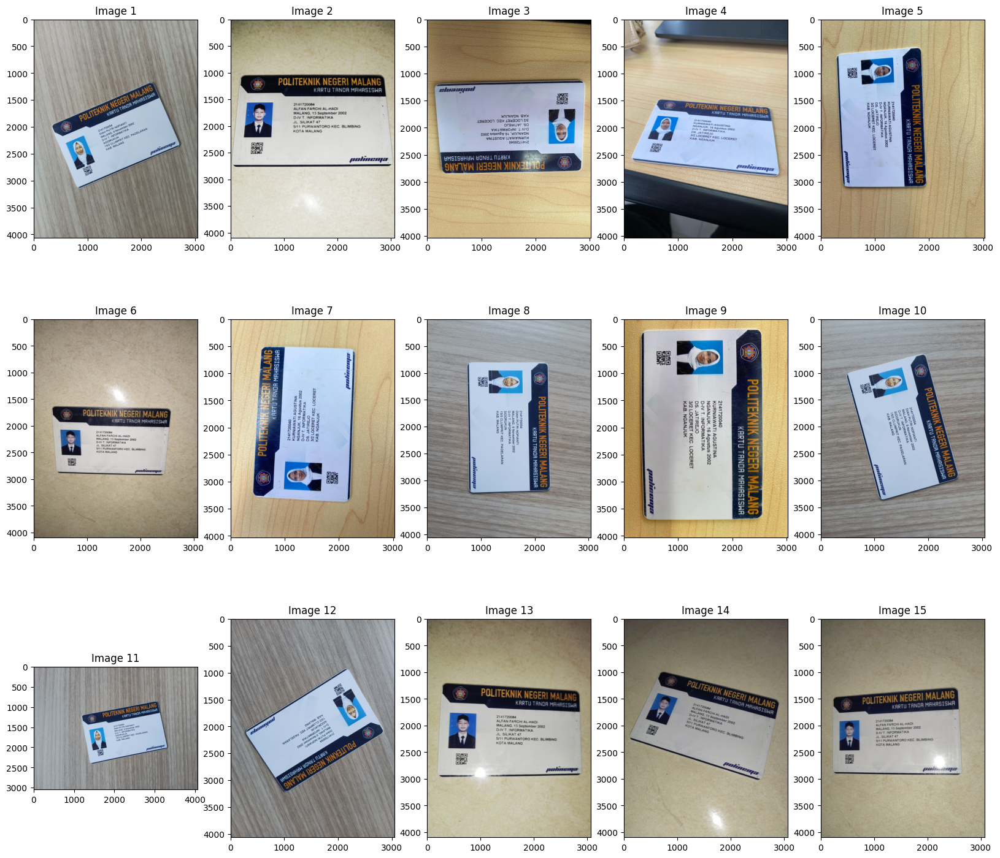

In [4]:
import os
import matplotlib.pyplot as plt
# Directory containing the images
directory_path = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/'

# List all files in the directory
image_paths = [os.path.join(directory_path, file) for file in os.listdir(directory_path) if file.endswith(('.jpg', '.jpeg', '.png'))]

# Create a subplot with a dynamic number of rows and columns based on the number of images
num_images = len(image_paths)
num_rows = (num_images // 5) + (num_images % 5 > 0)  # 5 images per row
plt.figure(figsize=(20, 6 * num_rows))

# Loop through the images and display them
for i, image_path in enumerate(image_paths, start=1):
    # Read the image using OpenCV
    image = cv2.imread(image_path)

    # Convert BGR to RGB (matplotlib uses RGB)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Create a subplot for each image
    plt.subplot(num_rows, 5, i)
    plt.imshow(image_rgb)
    plt.axis('on')  # Remove axis
    plt.title(f'Image {i}')

plt.show()


In [5]:
from PIL import Image
import matplotlib.pyplot as plt

def convert_to_grayscale(img):
    mode = img.mode
    if mode in ('RGBA', 'RGB'):
        pixels = list(img.getdata())
        grayscale_pixels = [(r + g + b) // 3 for (r, g, b) in pixels]
        img_gray = Image.new('L', img.size)
        img_gray.putdata(grayscale_pixels)
        return img_gray
    else:
        return img

def resize_image(image, new_size):
    width, height = image.size
    new_width, new_height = new_size
    resized_image = image.resize((width * new_width, height * new_height))
    return resized_image

def rotate_and_resize_image(image_path, crop_box, new_size, rotation_angle, save_path):
    original_image = Image.open(image_path)

    plt.figure(figsize=(20, 6))
    # Original Image
    plt.subplot(1, 4, 1)
    plt.imshow(original_image)
    plt.title('Original Image')
    plt.axis('on')

    # Rotated Image
    rotated_image = original_image.rotate(rotation_angle)
    plt.subplot(1, 4, 2)
    plt.imshow(rotated_image)
    plt.title('Rotated Image')
    plt.axis('on')

    # Cropped Image
    cropped_image = rotated_image.crop(crop_box)
    plt.subplot(1, 4, 3)
    plt.imshow(cropped_image)
    plt.title('Cropped Image')
    plt.axis('off')

    # Resized Image
    grayscale_image = convert_to_grayscale(cropped_image)
    resized_image = resize_image(grayscale_image, new_size)
    plt.subplot(1, 4, 4)
    plt.imshow(resized_image, cmap='gray')  # Use 'gray' colormap for grayscale images
    plt.title('Resized Image')
    plt.axis('off')

    plt.show()

    # Save the resized image
    resized_image.save(save_path)
    print(f'Resized image saved to: {save_path}')


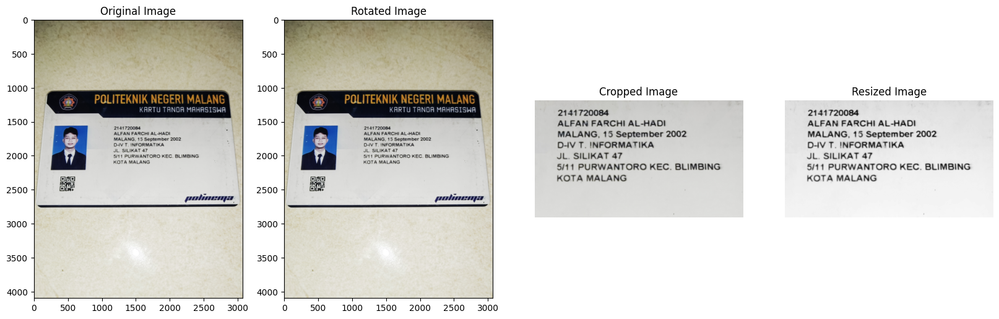

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image1.jpg


In [6]:
# Image path
image_path = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720084_1 - al.jpg'

# Crop box, new size, and rotation angle
crop_box = (1000, 1500, 2600, 2400)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 0  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image1.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path, crop_box, new_size, rotation_angle, save_path)

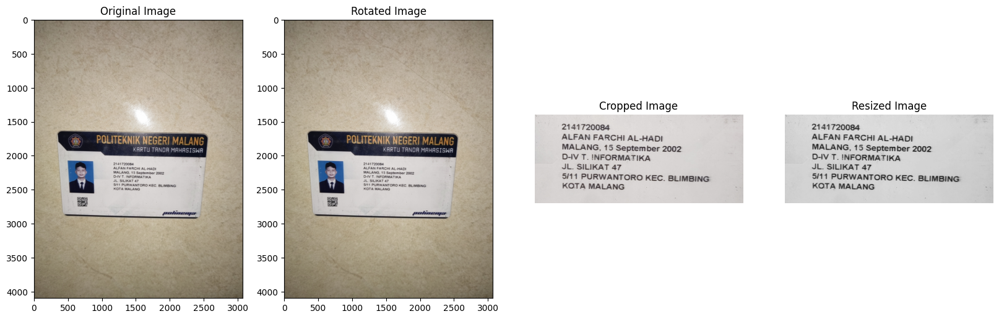

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image2.jpg


In [7]:
# Image path
image_path2 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720084_2 - al.jpg'

# Crop box, new size, and rotation angle
crop_box = (1000, 2050, 2300, 2600)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 0  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image2.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path2, crop_box, new_size, rotation_angle, save_path)


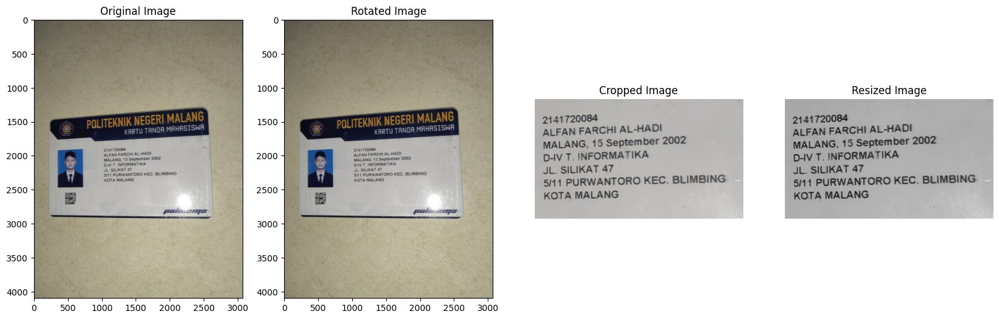

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image3.jpg


In [8]:
# Image path
image_path3 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720084_3 - al.jpg'

# Crop box, new size, and rotation angle
crop_box = (980, 1800, 2200, 2500)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 0  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image3.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path3, crop_box, new_size, rotation_angle, save_path)


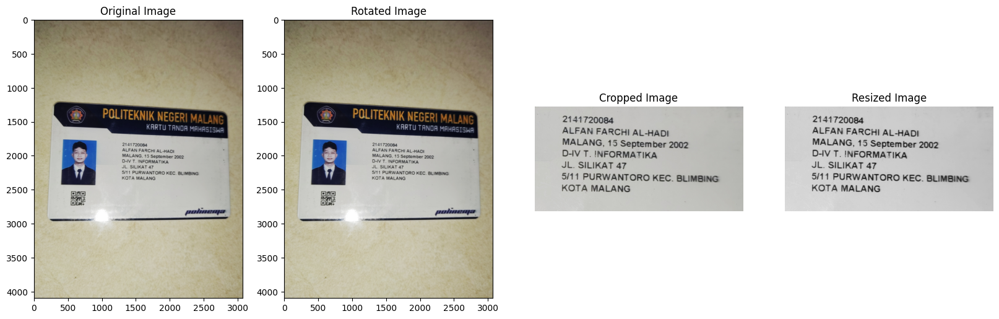

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image4.jpg


In [9]:
# Image path
image_path4 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720084_4 - al.jpg'

# Crop box, new size, and rotation angle
crop_box = (1100, 1750, 2600, 2500)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 0  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image4.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path4, crop_box, new_size, rotation_angle, save_path)


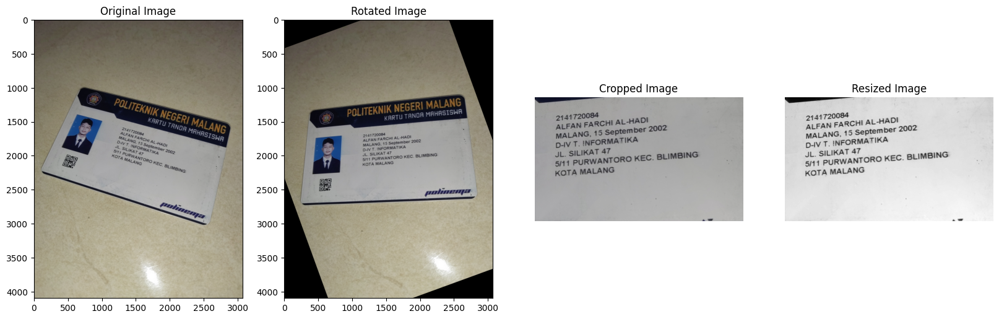

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image5.jpg


In [10]:
# Image path
image_path5 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720084_5 - al.jpg'

# Crop box, new size, and rotation angle
crop_box = (1000, 1550, 2600, 2500)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 20  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image5.jpg')

# Perform rotation, resizing, and display
resized_image = rotate_and_resize_image(image_path5, crop_box, new_size, rotation_angle, save_path)


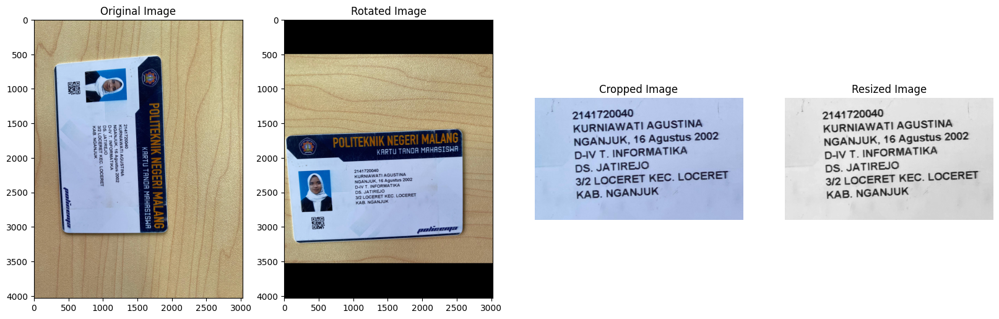

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image6.jpg


In [11]:
# Image path
image_path6 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720040_1 - KURNIAWATI AGUSTINA.jpeg'

# Crop box, new size, and rotation angle
crop_box = (800, 2100, 2000, 2800)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 90  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image6.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path6, crop_box, new_size, rotation_angle, save_path)


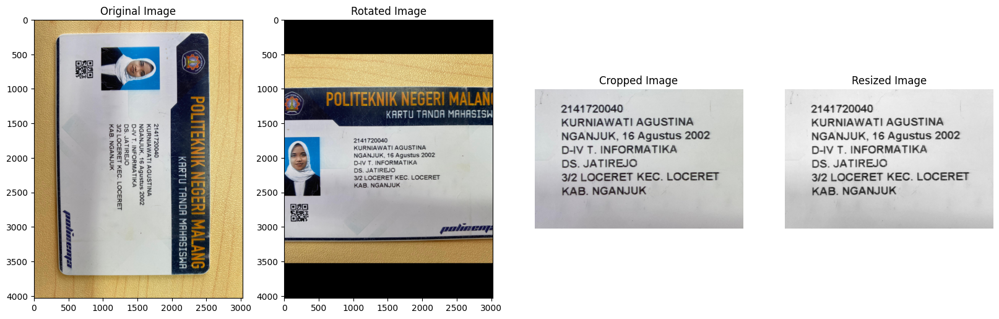

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image7.jpg


In [12]:
# Image path
image_path7 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720040_2.jpeg - KURNIAWATI AGUSTINA.jpeg'
# Crop box, new size, and rotation angle
crop_box = (800, 1600, 2450, 2700)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 90  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image7.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path7, crop_box, new_size, rotation_angle, save_path)


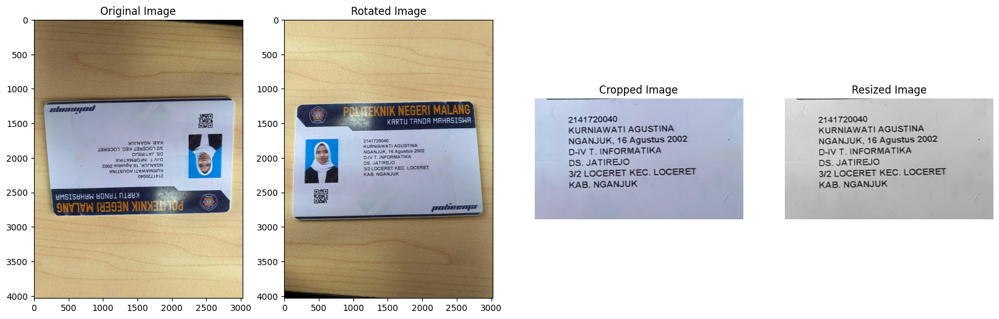

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image8.jpg


In [13]:
# Image path
image_path8 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720040_3.jpeg - KURNIAWATI AGUSTINA.jpeg'
# Crop box, new size, and rotation angle
crop_box = (900, 1600, 2450, 2500)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 180  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image8.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path8, crop_box, new_size, rotation_angle, save_path)


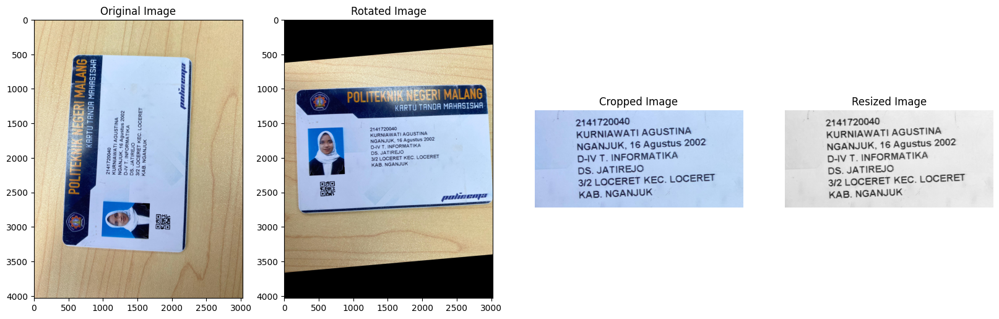

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image9.jpg


In [14]:
# Image path
image_path9 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720040_4.jpeg - KURNIAWATI AGUSTINA.jpeg'
# Crop box, new size, and rotation angle
crop_box = (950, 1500, 2450, 2200)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 275  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image9.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path9, crop_box, new_size, rotation_angle, save_path)


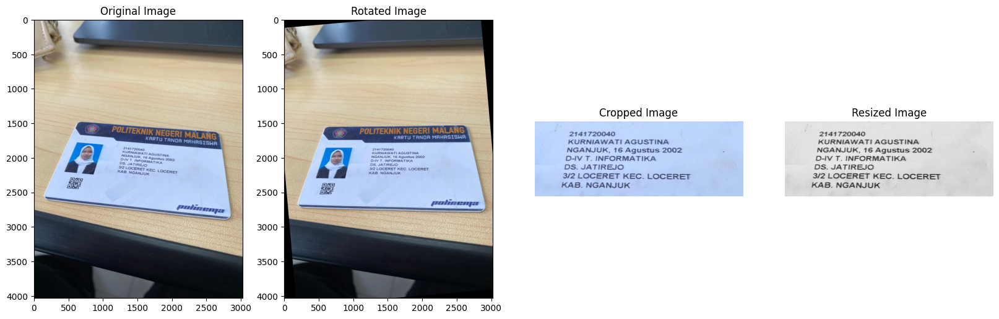

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image10.jpg


In [15]:
# Image path
image_path10 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720040_5.jpeg - KURNIAWATI AGUSTINA.jpeg'
# Crop box, new size, and rotation angle
crop_box = (1050, 1800, 2450, 2300)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 5 # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image10.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path10, crop_box, new_size, rotation_angle, save_path)


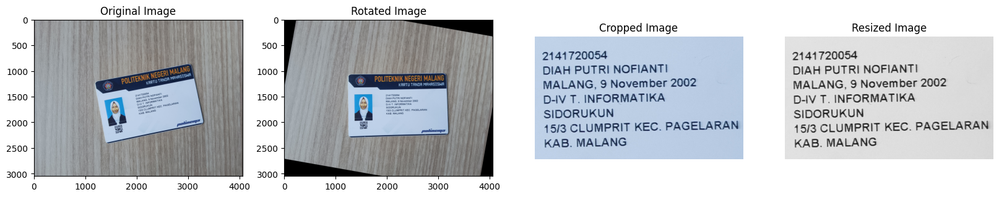

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image11.jpg


In [16]:
# Image path
image_path11 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720054_1 - Diah Putri Nofianti.jpg'
# Crop box, new size, and rotation angle
crop_box = (1950, 1400, 2800, 1900)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 350  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image11.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path11, crop_box, new_size, rotation_angle, save_path)


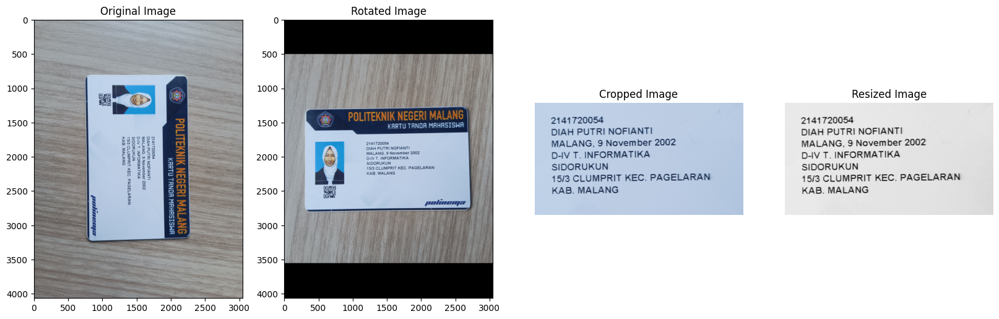

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image12.jpg


In [17]:
# Image path
image_path12 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720054_2 - Diah Putri Nofianti.jpg'
# Crop box, new size, and rotation angle
crop_box = (1100, 1700, 2400, 2400)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 90  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image12.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path12, crop_box, new_size, rotation_angle, save_path)


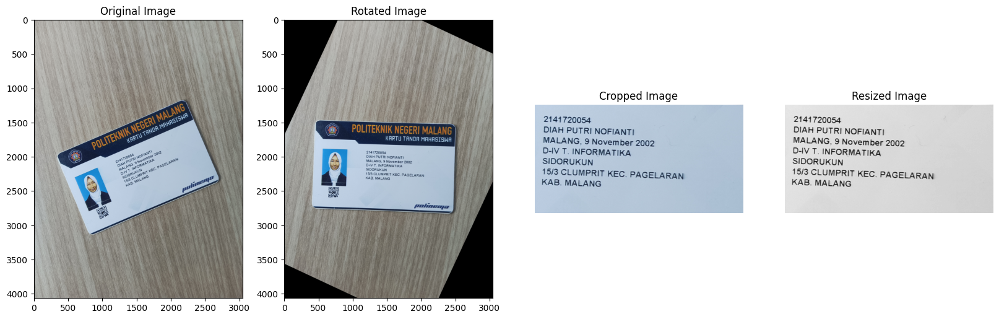

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image13.jpg


In [18]:
# Image path
image_path13 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720054_3 - Diah Putri Nofianti.jpg'
# Crop box, new size, and rotation angle
crop_box = (1150, 1850, 2400, 2500)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 335  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image13.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path13, crop_box, new_size, rotation_angle, save_path)


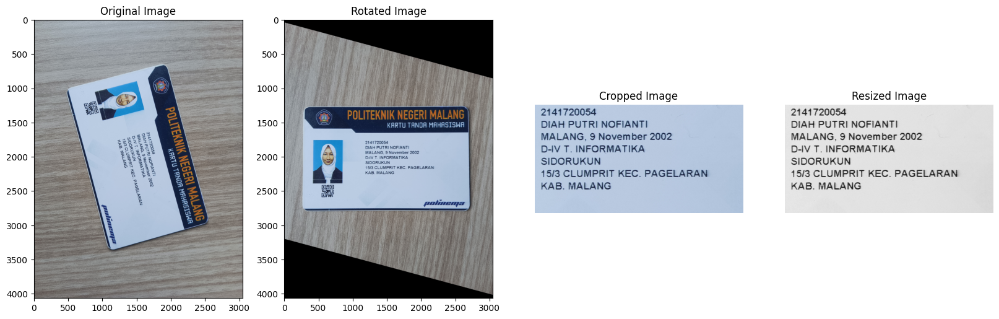

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image14.jpg


In [19]:
# Image path
image_path14 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720054_4 - Diah Putri Nofianti.jpg'
# Crop box, new size, and rotation angle
crop_box = (1150, 1750, 2400, 2400)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 75  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image14.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path14, crop_box, new_size, rotation_angle, save_path)


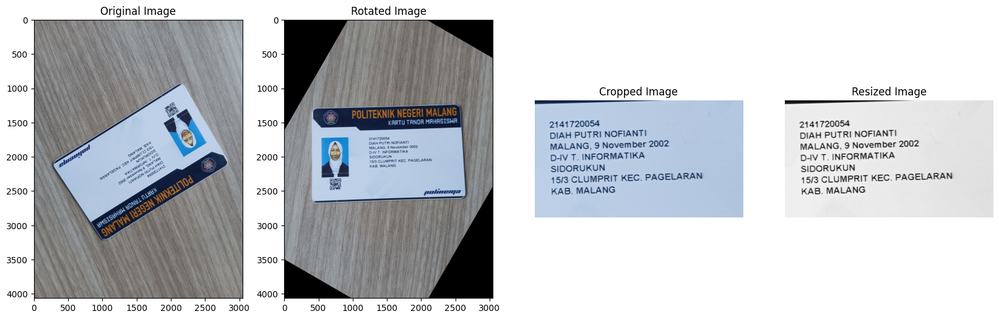

Resized image saved to: /content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/resized_image15.jpg


In [20]:
# Image path
image_path15 = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/3A_2141720054_5 - Diah Putri Nofianti.jpg'
# Crop box, new size, and rotation angle
crop_box = (1150, 1600, 2400, 2300)  # Example crop box (left, top, right, bottom)
new_size = (3, 3)
rotation_angle = 150  # Specify the rotation angle

# Output directory
output_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages/'
os.makedirs(output_directory, exist_ok=True)

# Save path
save_path = os.path.join(output_directory, 'resized_image15.jpg')

# Perform rotation, resizing, and display
rotate_and_resize_image(image_path15, crop_box, new_size, rotation_angle, save_path)


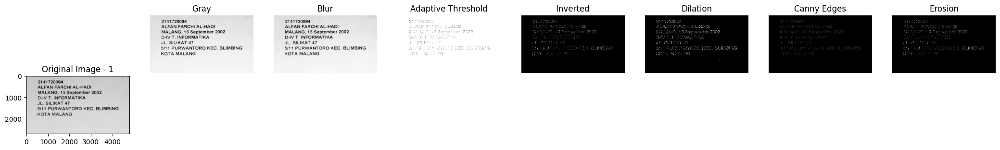

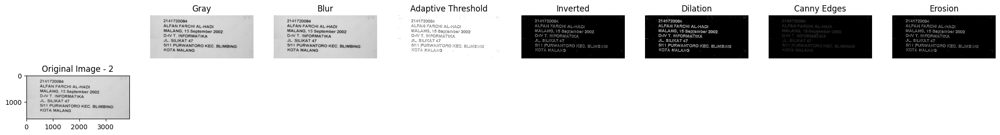

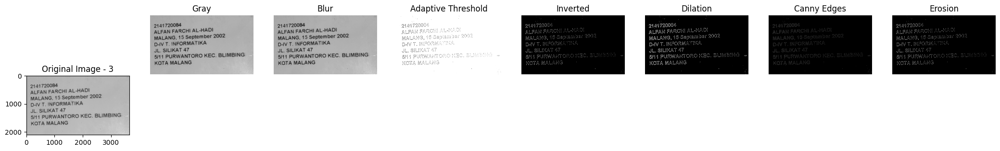

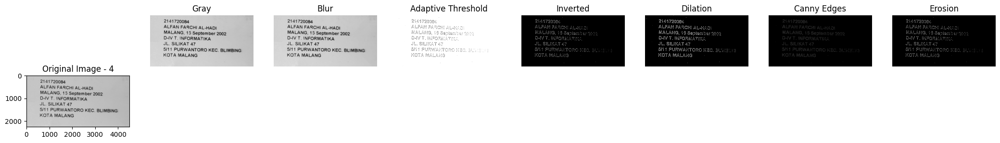

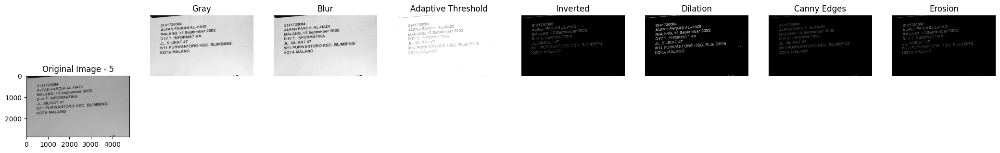

...

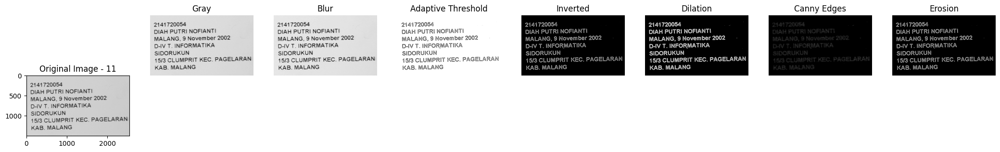

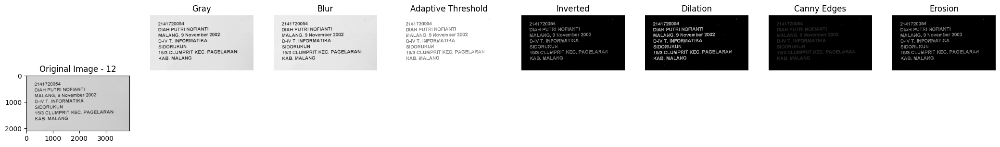

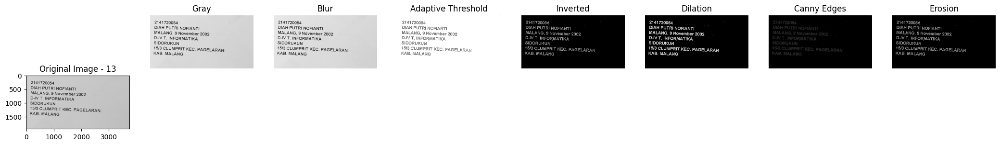

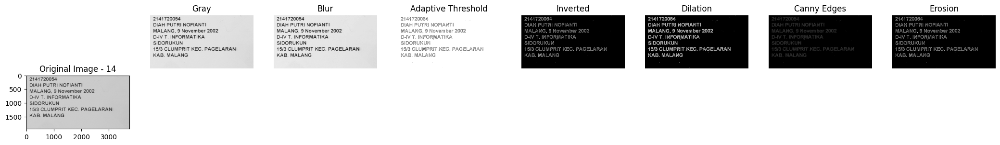

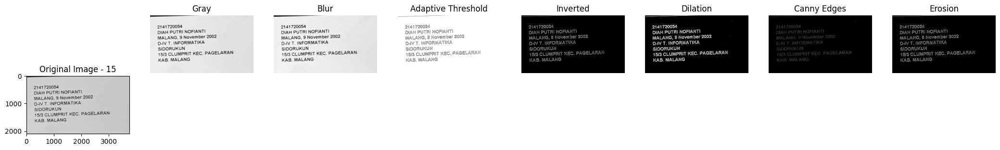

In [21]:
# Path to the directory containing resized images
resized_images_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages'

# Get a list of all image files in the directory
image_files = [f for f in os.listdir(resized_images_directory) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Display original and preprocessed images side by side
for i, image_file in enumerate(image_files):
    # Read the original image using OpenCV
    img_path = os.path.join(resized_images_directory, image_file)
    original_img = cv2.imread(img_path)

    # Convert to grayscale
    gray = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)

    # Gaussian Blur
    blur = cv2.GaussianBlur(gray, (3, 3), 0)

    # Adaptive Thresholding
    adaptive = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 15, 5)

    # Invert image
    invertion = 255 - adaptive

    # Dilation
    dilation = cv2.dilate(invertion, np.ones((3, 3)))

    # Canny Edge Detection
    edges = cv2.Canny(dilation, 40, 150)

    # Erosion
    erode = cv2.erode(invertion, np.ones((1, 1)))

    # Display original and processed images side by side
    plt.figure(figsize=(26, 6))

    # Original Image
    plt.subplot(1, 8, 1)
    plt.imshow(cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for displaying with matplotlib
    plt.title(f'Original Image - {i+1}')
    plt.axis('on')

    # Processed Images
    processed_images = [gray, blur, adaptive, invertion, dilation, edges, erode]
    titles = ['Gray', 'Blur', 'Adaptive Threshold', 'Inverted', 'Dilation', 'Canny Edges', 'Erosion']

    for j in range(len(processed_images)):
        plt.subplot(2, 8, j + 2)
        plt.imshow(processed_images[j], cmap='gray')
        plt.title(titles[j])
        plt.axis('off')

    plt.show()


##FIND CONTOUR

Jumlah kontur pada gambar resized_image1.jpg: 14607


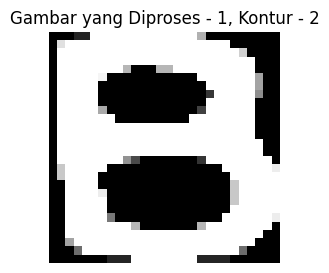

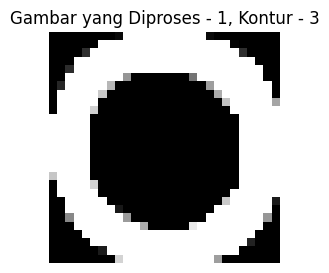

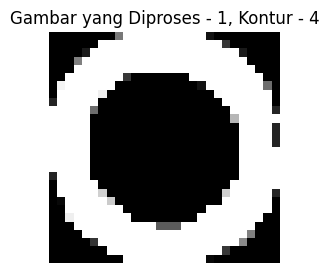

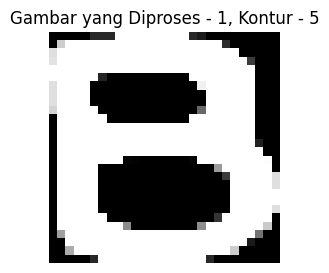

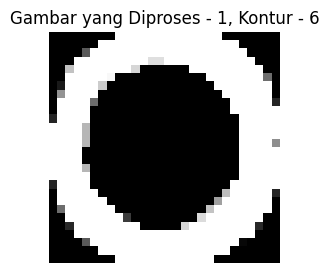

...

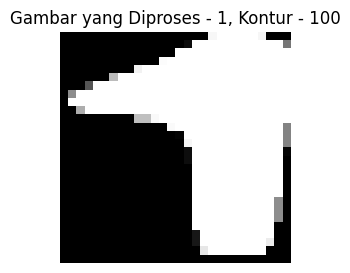

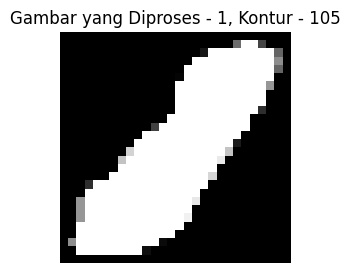

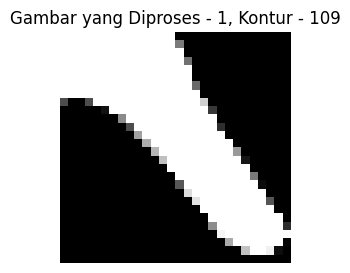

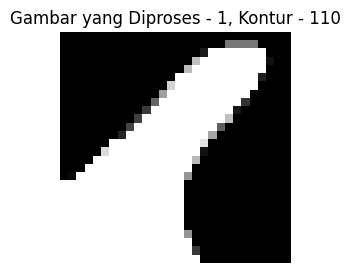

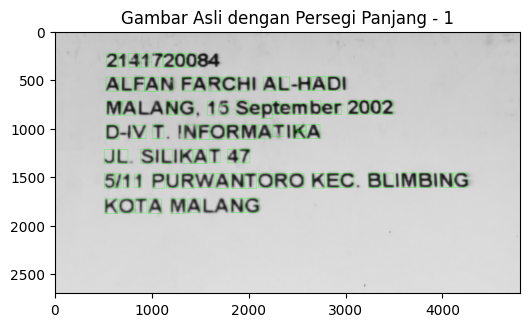

Jumlah kontur pada gambar resized_image2.jpg: 18590


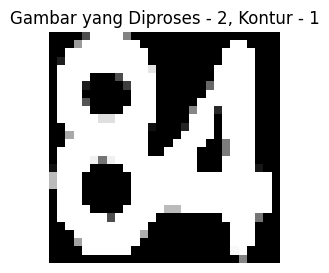

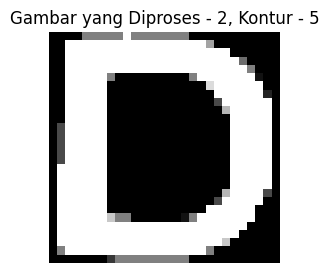

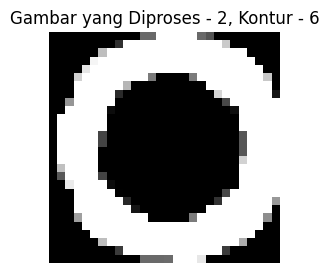

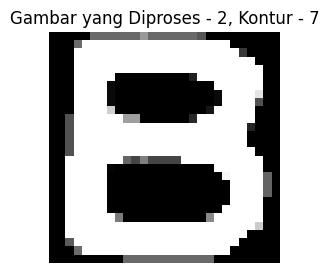

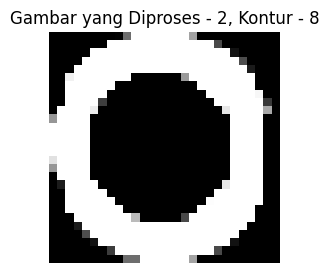

...

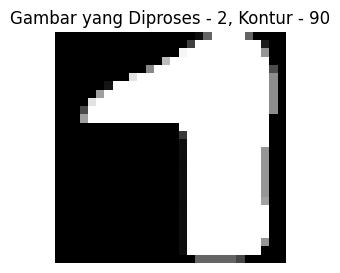

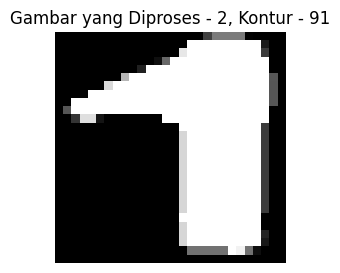

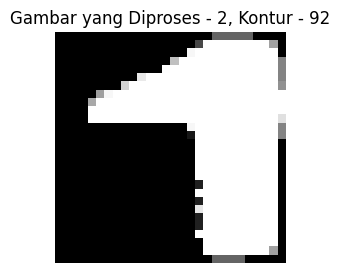

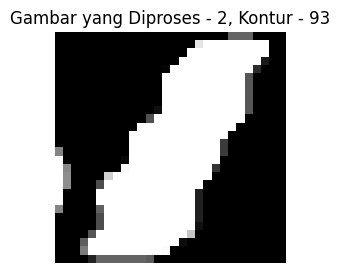

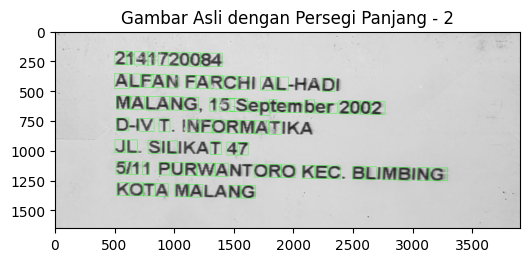

Jumlah kontur pada gambar resized_image3.jpg: 14607


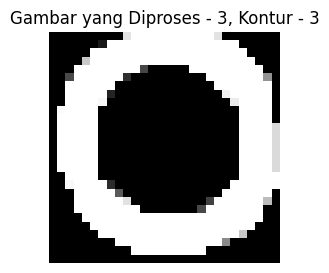

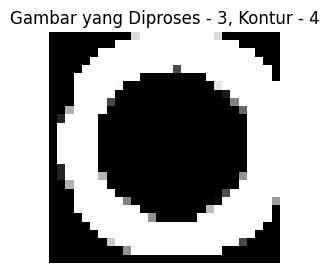

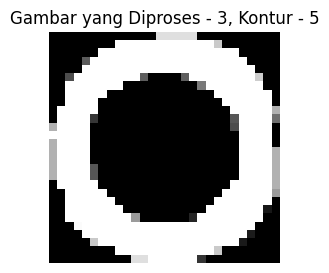

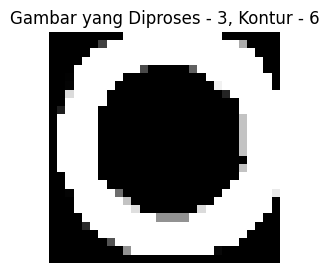

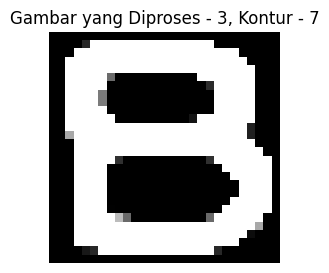

...

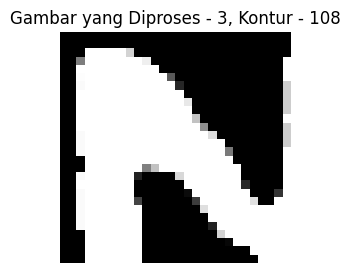

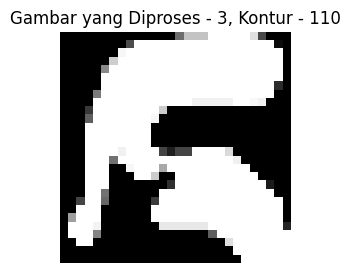

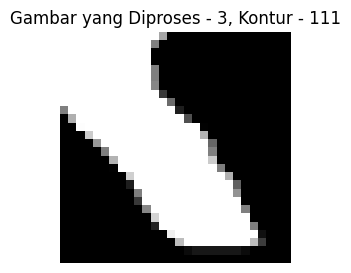

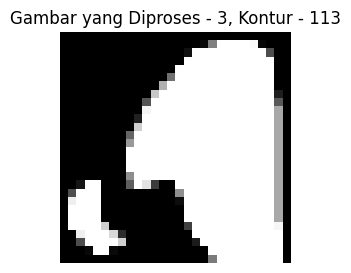

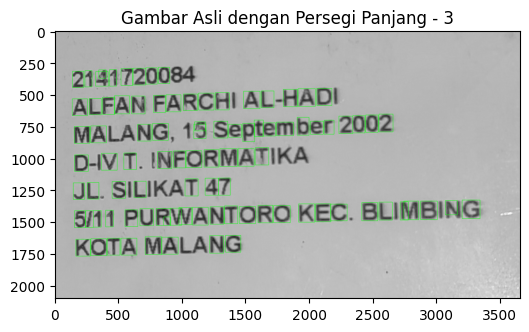

Jumlah kontur pada gambar resized_image4.jpg: 14170


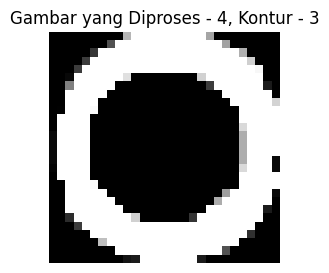

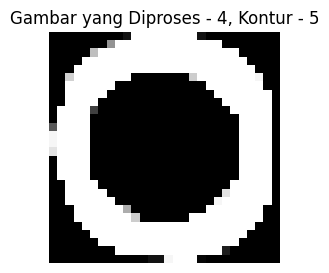

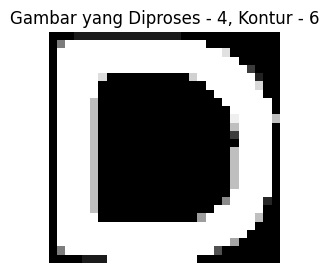

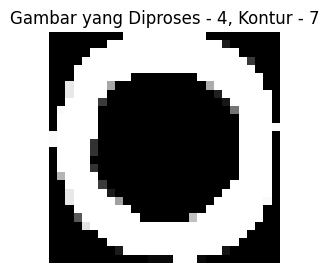

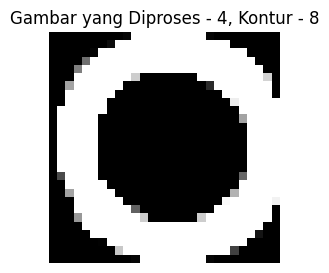

...

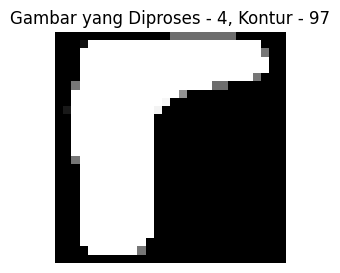

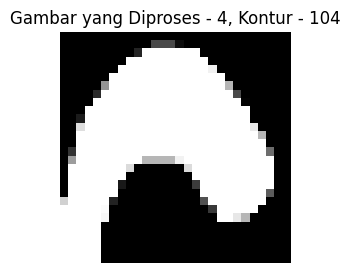

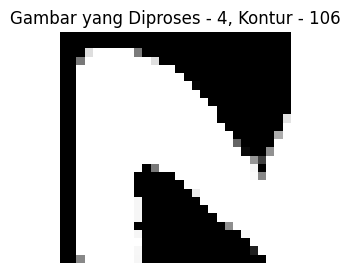

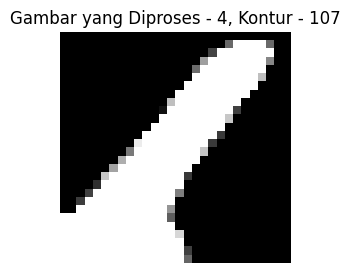

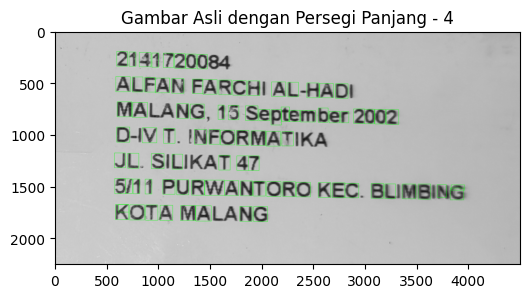

Jumlah kontur pada gambar resized_image5.jpg: 19999


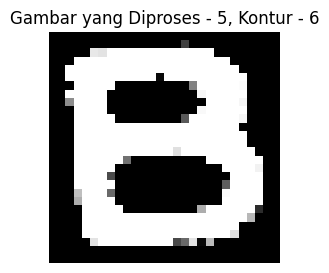

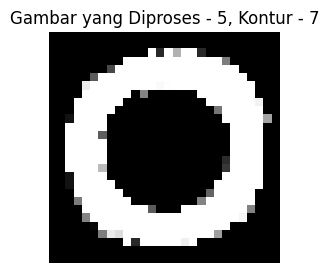

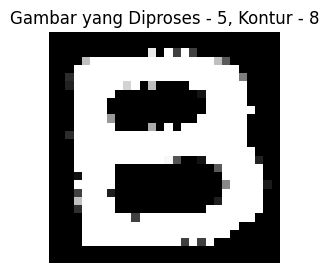

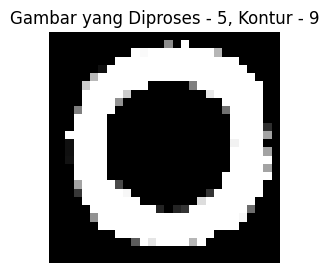

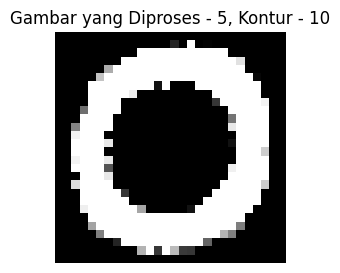

...

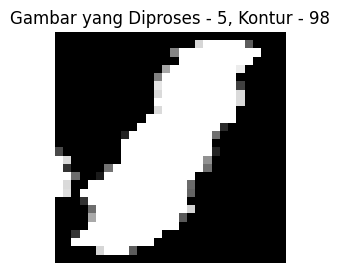

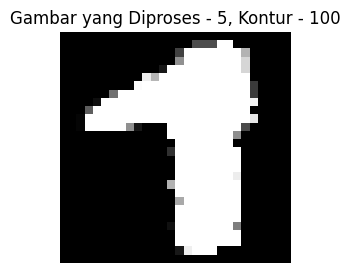

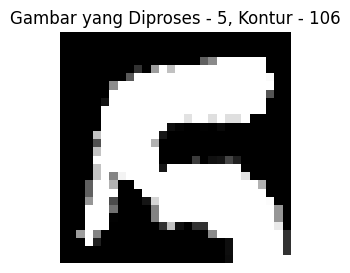

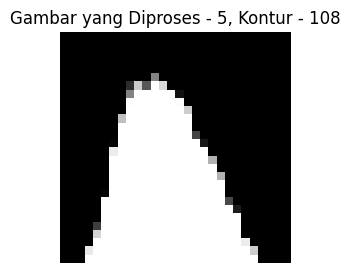

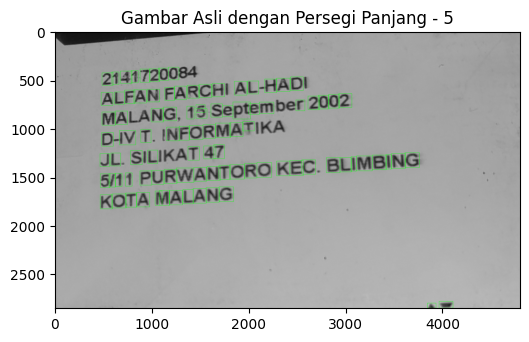

Jumlah kontur pada gambar resized_image6.jpg: 18175


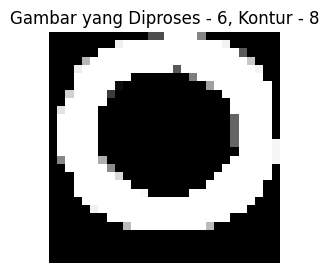

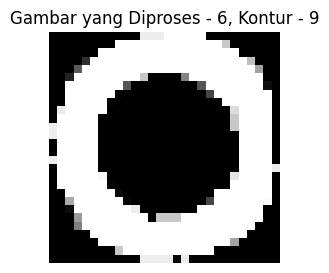

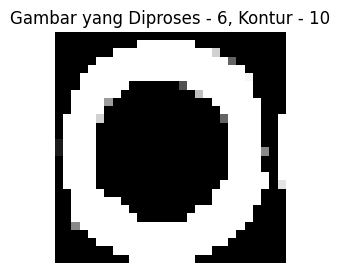

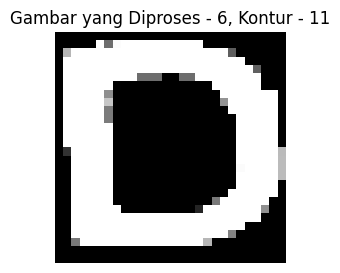

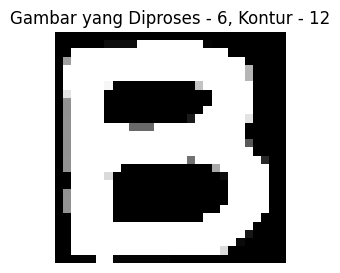

...

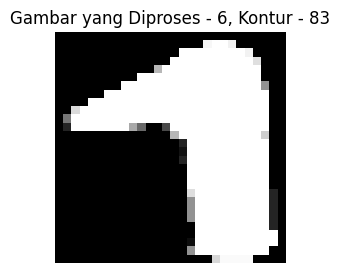

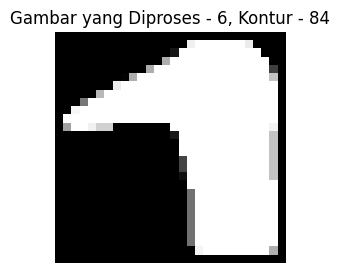

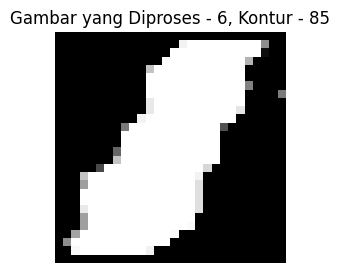

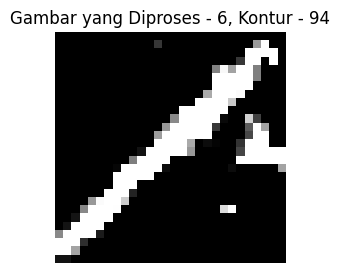

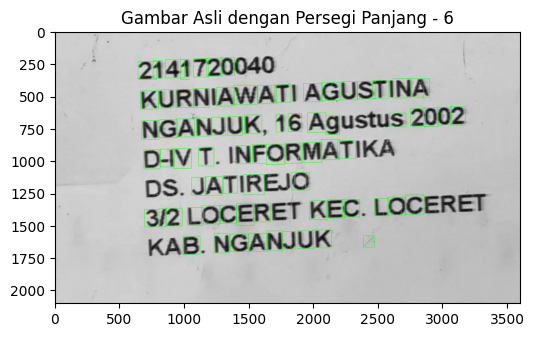

Jumlah kontur pada gambar resized_image7.jpg: 55664


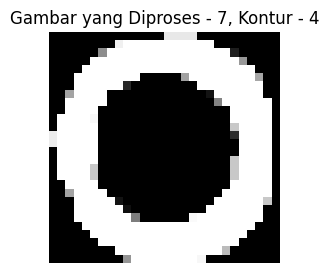

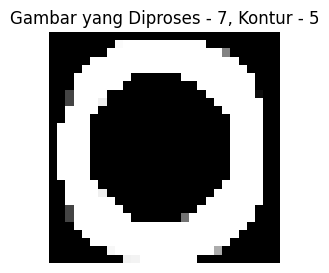

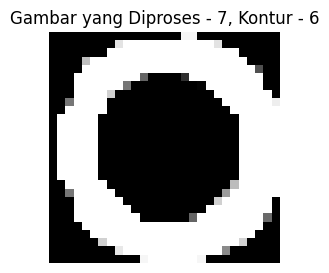

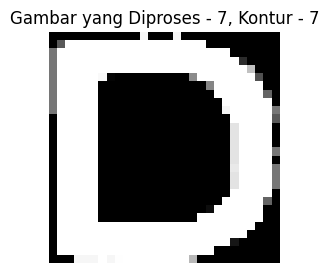

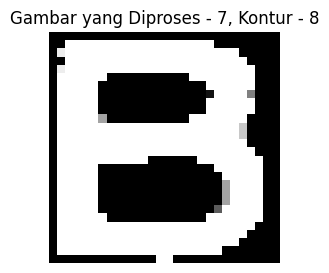

...

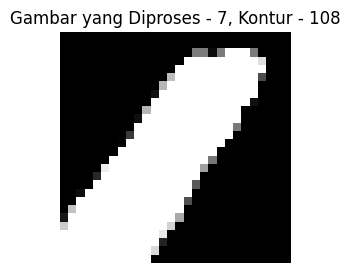

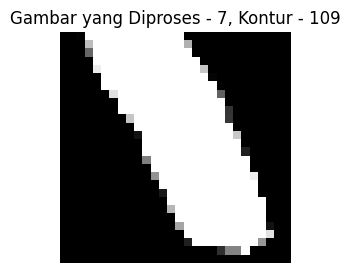

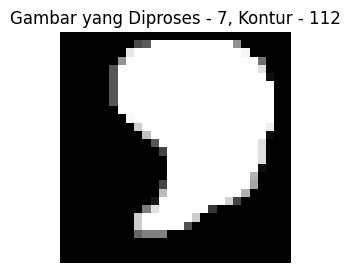

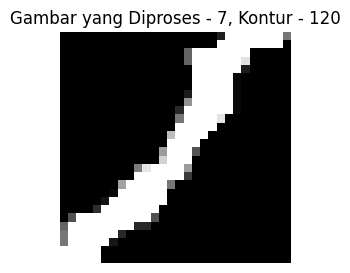

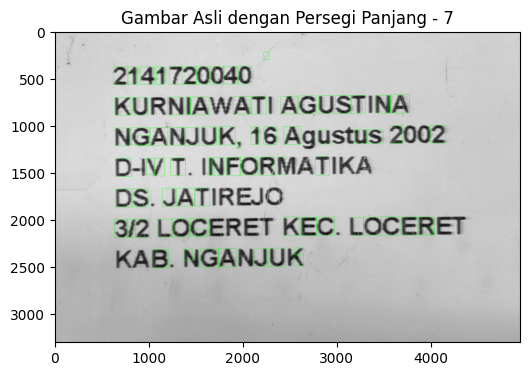

Jumlah kontur pada gambar resized_image8.jpg: 60610


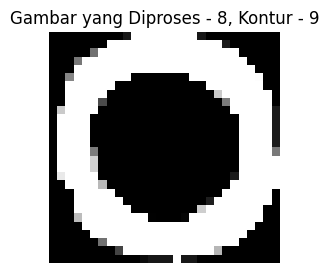

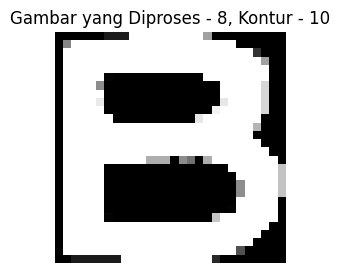

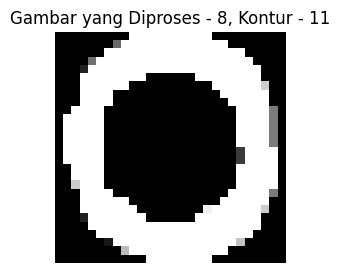

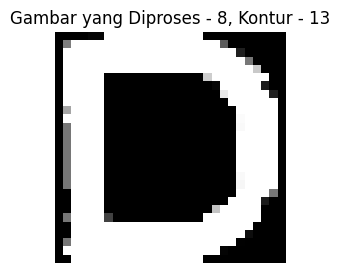

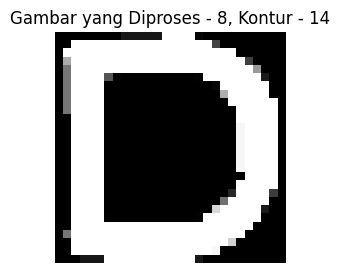

...

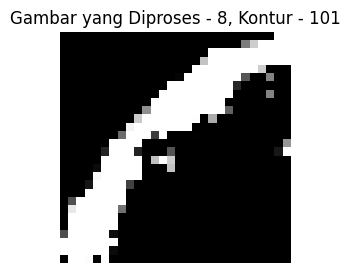

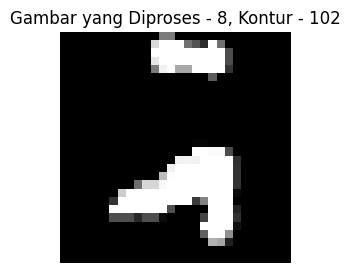

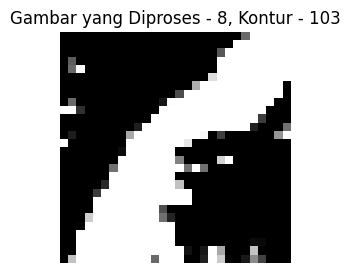

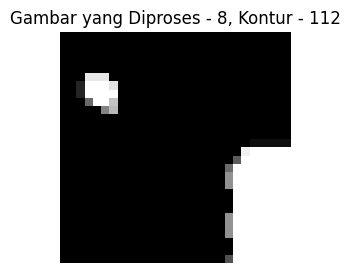

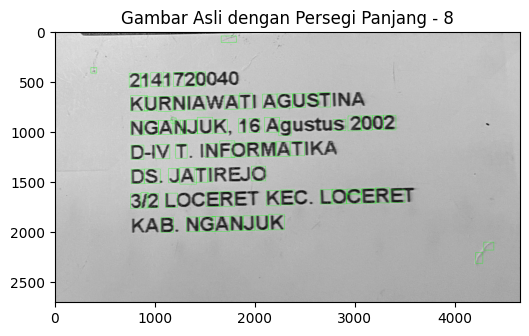

Jumlah kontur pada gambar resized_image9.jpg: 14363


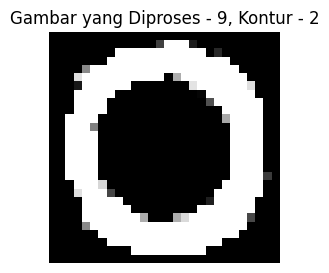

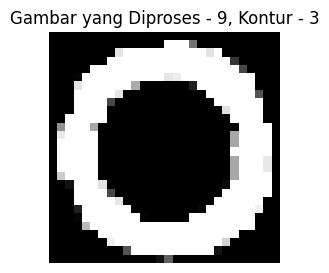

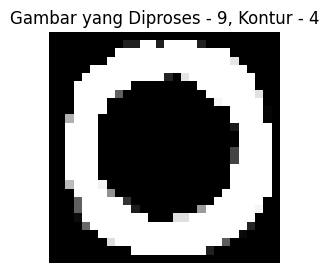

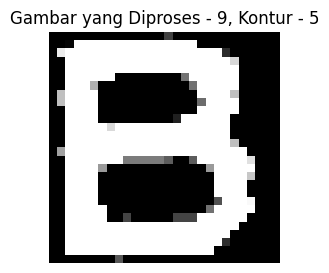

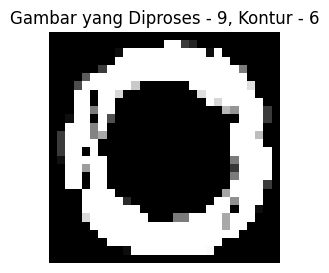

...

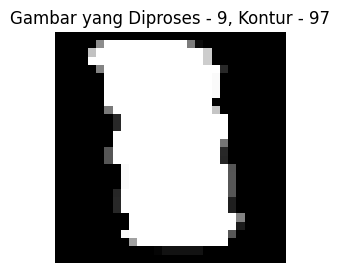

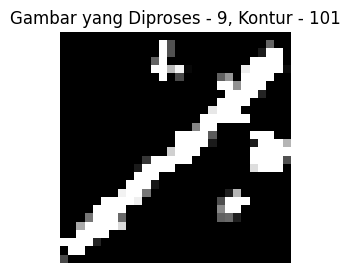

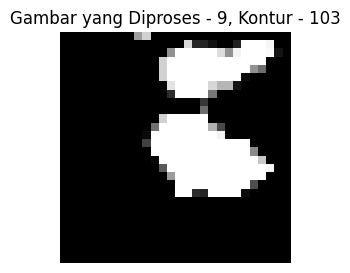

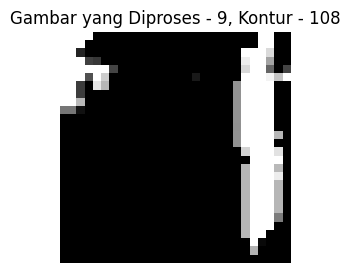

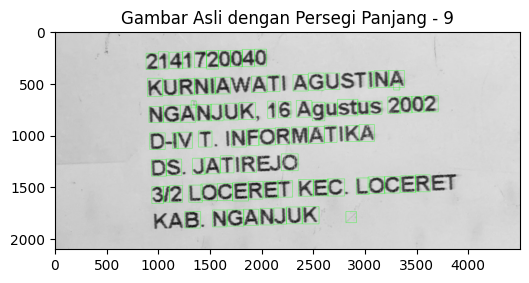

Jumlah kontur pada gambar resized_image10.jpg: 7590


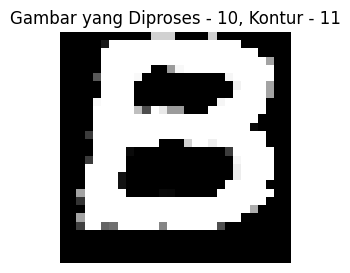

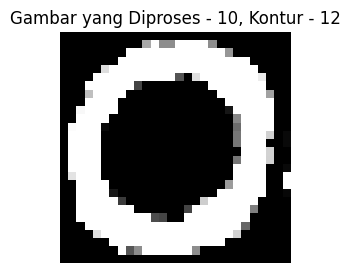

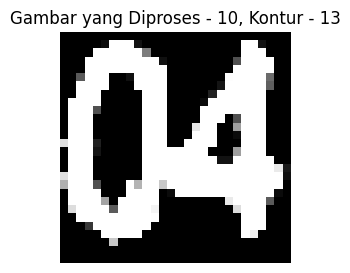

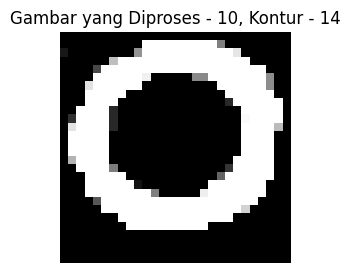

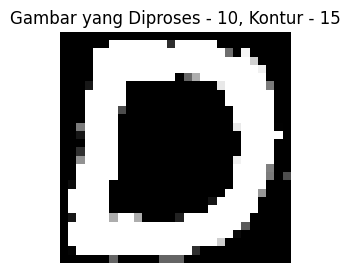

...

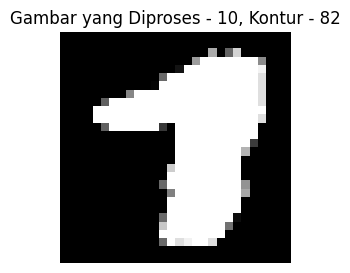

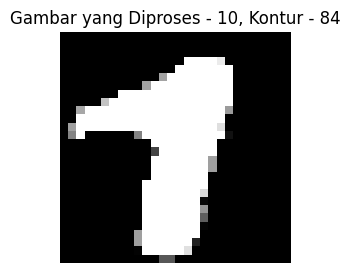

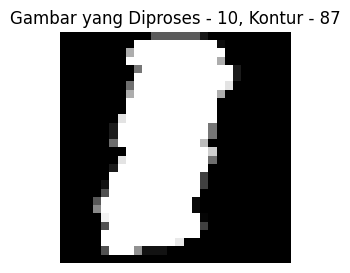

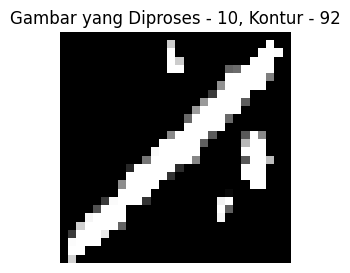

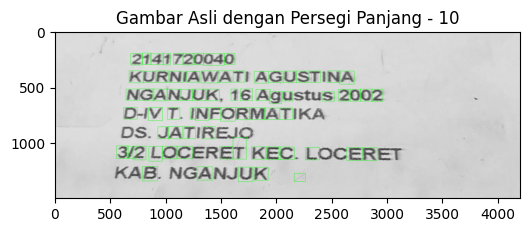

Jumlah kontur pada gambar resized_image11.jpg: 16328


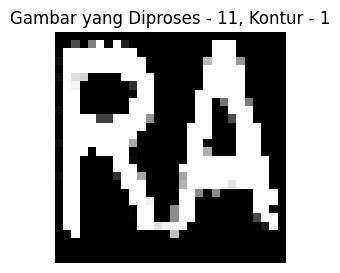

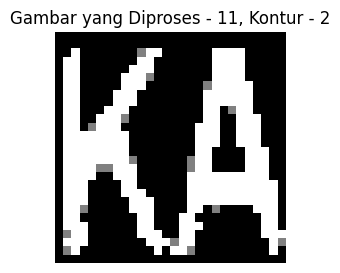

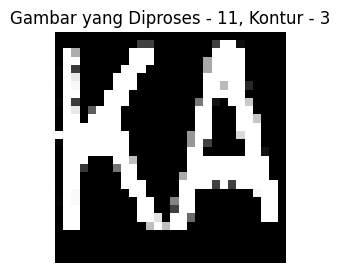

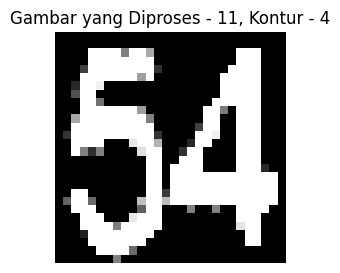

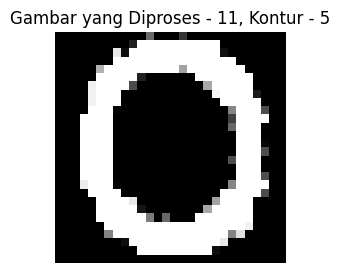

...

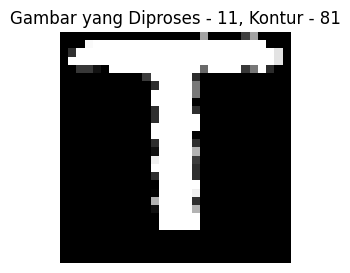

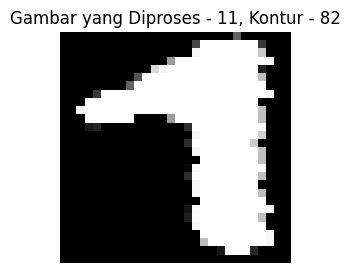

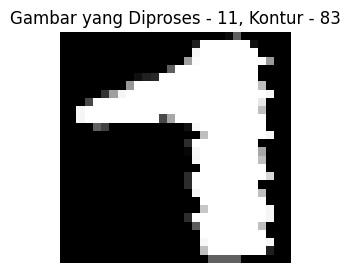

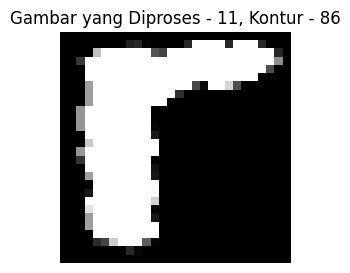

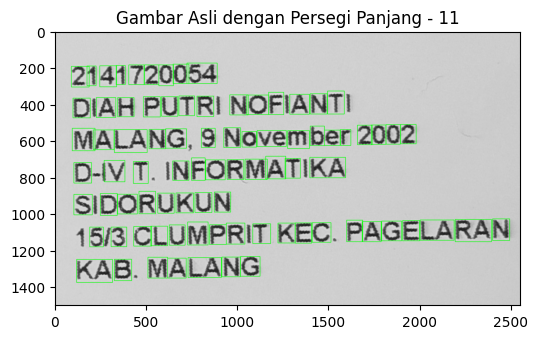

Jumlah kontur pada gambar resized_image12.jpg: 34817


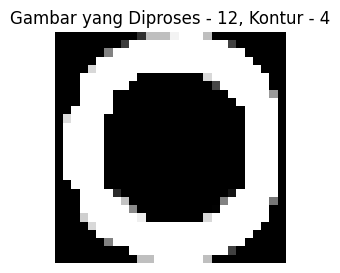

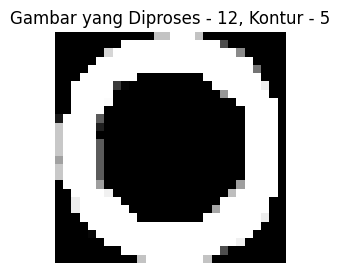

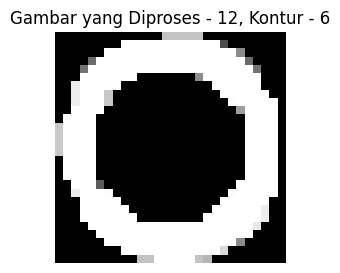

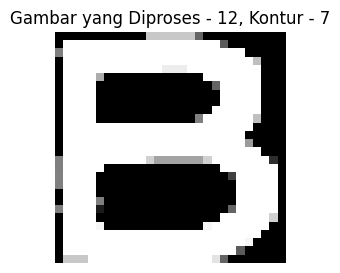

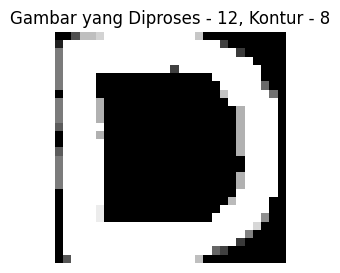

...

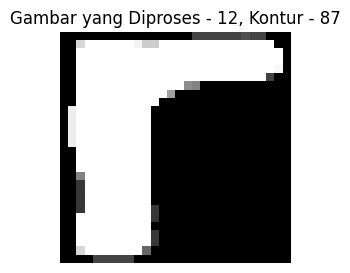

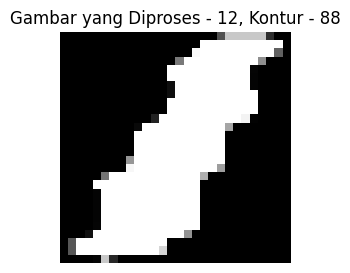

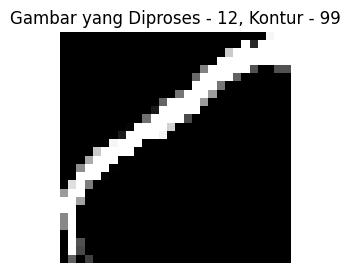

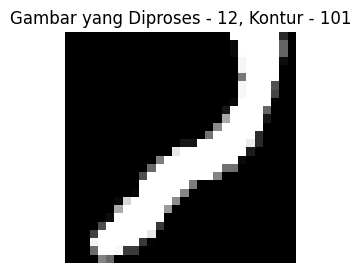

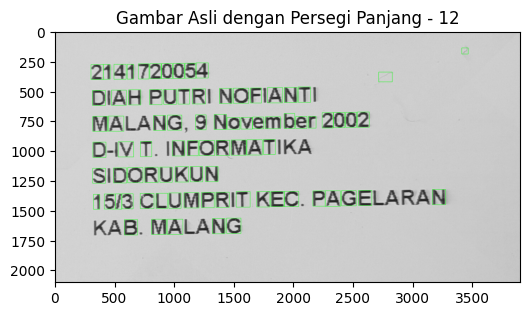

Jumlah kontur pada gambar resized_image13.jpg: 35508


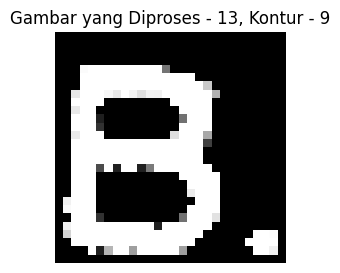

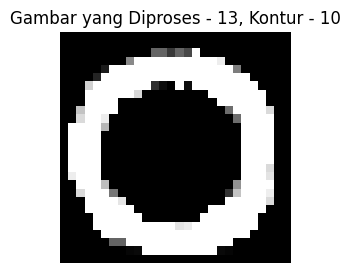

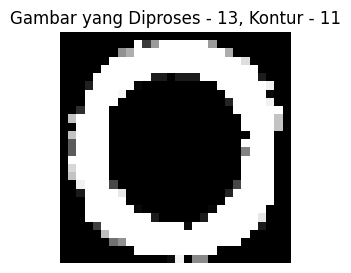

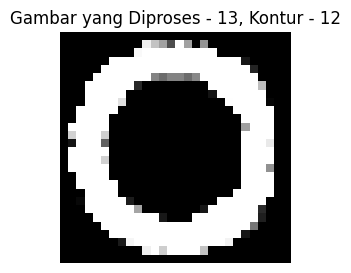

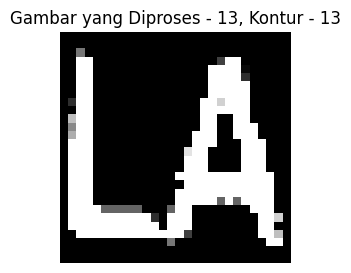

...

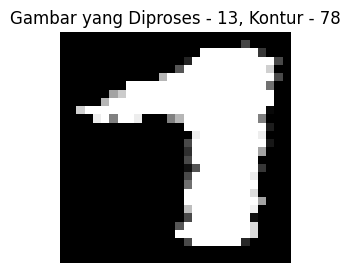

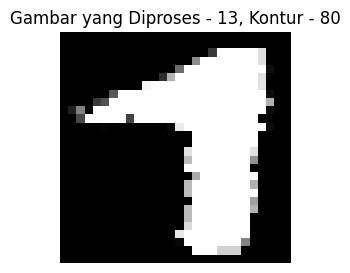

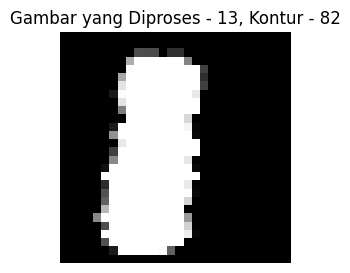

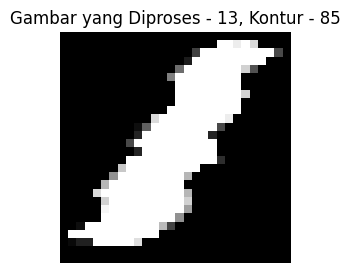

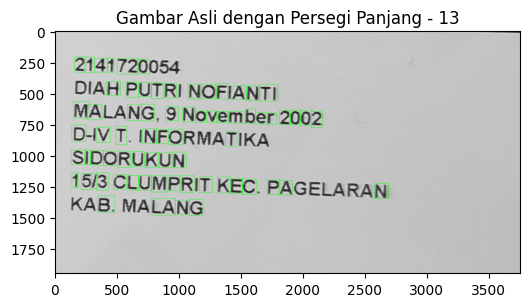

Jumlah kontur pada gambar resized_image14.jpg: 33175


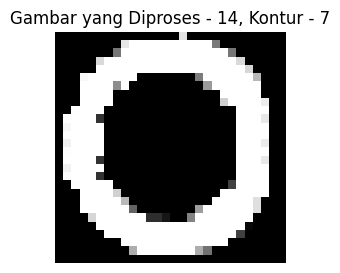

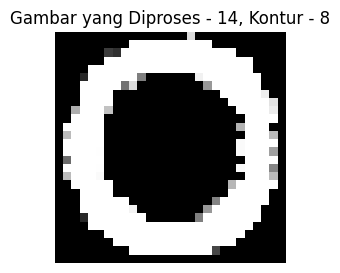

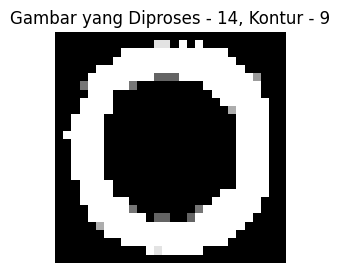

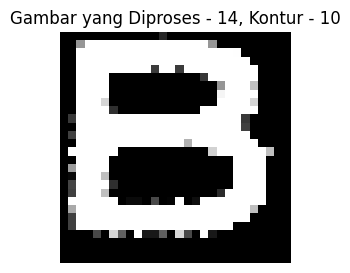

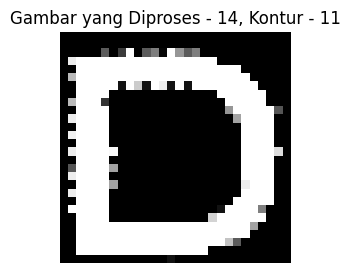

...

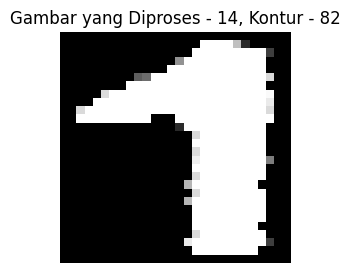

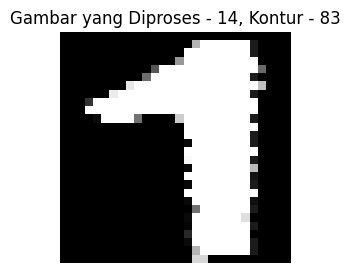

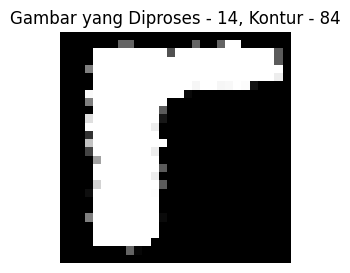

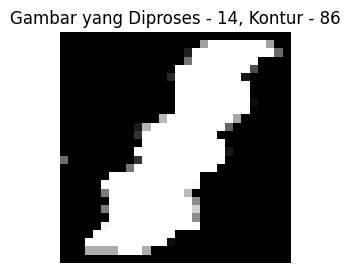

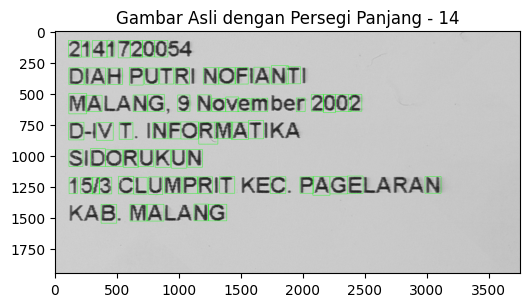

Jumlah kontur pada gambar resized_image15.jpg: 30982


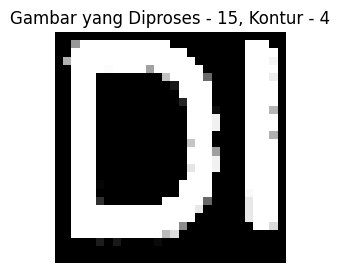

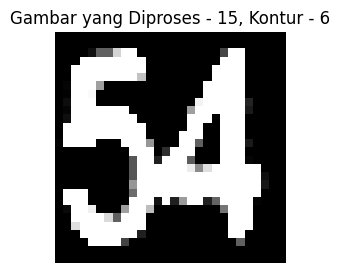

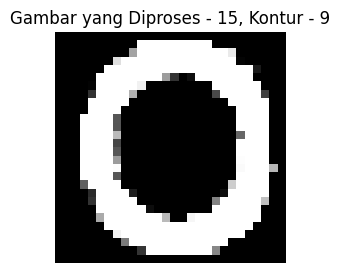

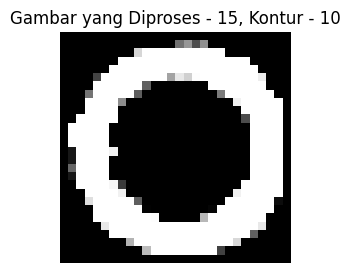

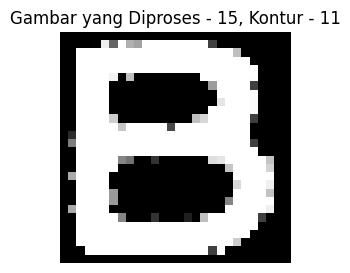

...

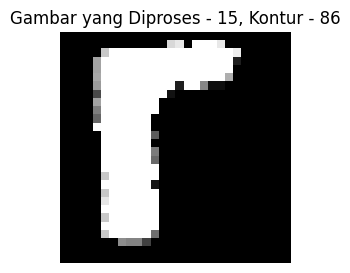

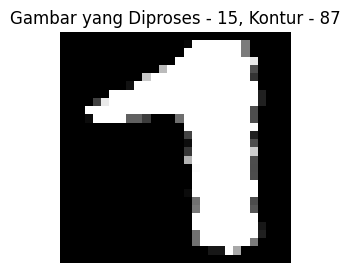

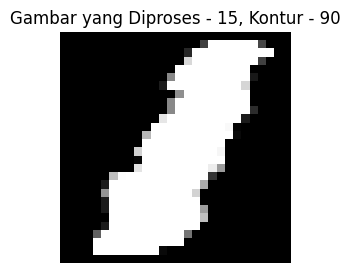

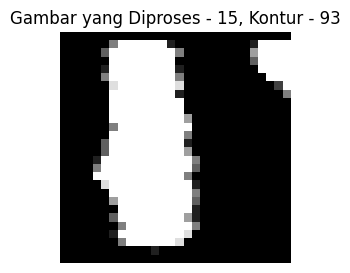

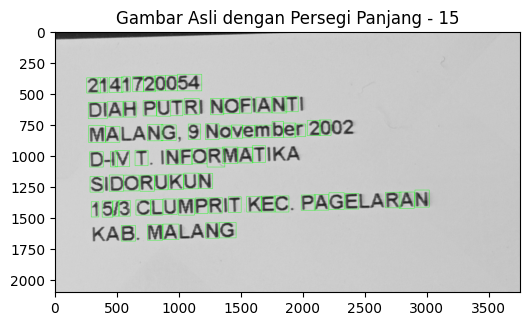

In [22]:
# Fungsi untuk deteksi kontur
def find_contours(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sorted(conts, key=cv2.contourArea, reverse=True)

    return conts

# Path ke direktori yang berisi gambar yang sudah diubah ukurannya
resized_images_directory = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages'

# Dapatkan daftar semua file gambar di direktori
image_files = [f for f in os.listdir(resized_images_directory) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Atur lebar/tinggi minimum/maksimum untuk karakter
min_w, max_w = 50, 200  # Sesuaikan lebar minimum dan maksimum sesuai kebutuhan
min_h, max_h = 50, 200  # Sesuaikan tinggi minimum dan maksimum sesuai kebutuhan

# Iterasi melalui setiap gambar di direktori
for i, image_file in enumerate(image_files):
    # Baca gambar asli menggunakan OpenCV
    img_path = os.path.join(resized_images_directory, image_file)
    img = cv2.imread(img_path)
    img_copy = img.copy()  # gambar asli untuk menampilkan hasil deteksi kontur

    # Konversi ke citra skala abu-abu
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Terapkan threshold adaptif
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)

    # Temukan kontur pada gambar yang sudah diproses
    dilation = cv2.dilate(thresh, np.ones((3, 3)))
    conts = find_contours(dilation.copy())

    print(f"Jumlah kontur pada gambar {image_file}: {len(conts)}")

    # Iterasi melalui kontur dan ekstrak karakter
    for j, c in enumerate(conts):
        (x, y, w, h) = cv2.boundingRect(c)

        # Periksa apakah ukuran kotak pembatas berada dalam rentang yang spesifik
        if min_w <= w <= max_w and min_h <= h <= max_h:
            # Ekstrak ROI
            roi = gray[y:y+h, x:x+w]

            # Thresholding
            thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

            # Ubah ukuran gambar
            resized_img = cv2.resize(thresh, (28, 28))

            # Tampilkan gambar yang dinormalisasi dan diproses
            normalized_img = resized_img.astype('float32') / 255.0  # konversi ke floating point
            normalized_img = np.expand_dims(normalized_img, axis=-1)  # tambahkan kedalaman

            # Gambar persegi panjang di gambar asli
            cv2.rectangle(img_copy, (x, y), (x + w, y + h), (0, 255, 0), 2)

            plt.figure(figsize=(3, 3))
            plt.imshow(normalized_img[:, :, 0], cmap='gray')  # Tampilkan gambar yang dinormalisasi
            plt.title(f'Gambar yang Diproses - {i+1}, Kontur - {j+1}')
            plt.axis('off')
            plt.show()

    # Tampilkan gambar asli dengan persegi panjang
    plt.figure(figsize=(6, 6))
    plt.imshow(cv2.cvtColor(img_copy, cv2.COLOR_BGR2RGB))
    plt.title(f'Gambar Asli dengan Persegi Panjang - {i+1}')
    plt.axis('on')
    plt.show()


##PROCESS

Jumlah kontur pada gambar resized_image1.jpg: 14607
4/4 [==============================] - 0s 17ms/step


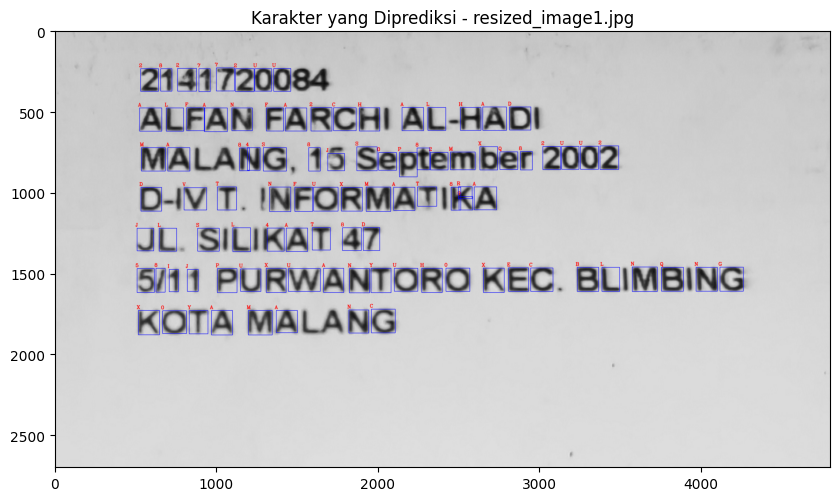

Jumlah kontur pada gambar resized_image2.jpg: 18590
3/3 [==============================] - 0s 17ms/step


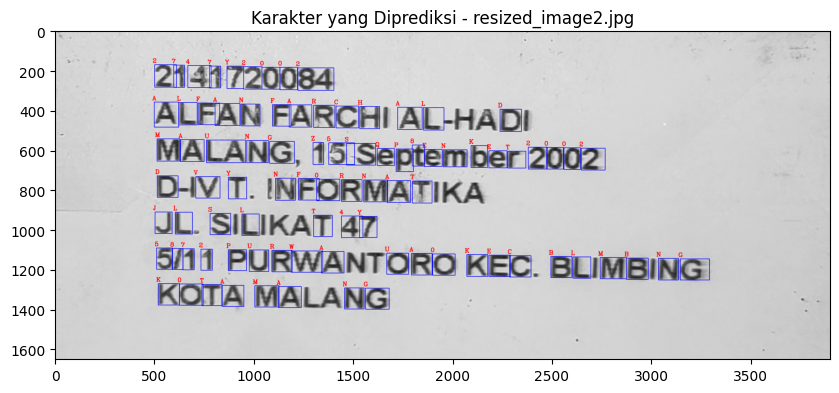

Jumlah kontur pada gambar resized_image3.jpg: 14607
3/3 [==============================] - 0s 17ms/step


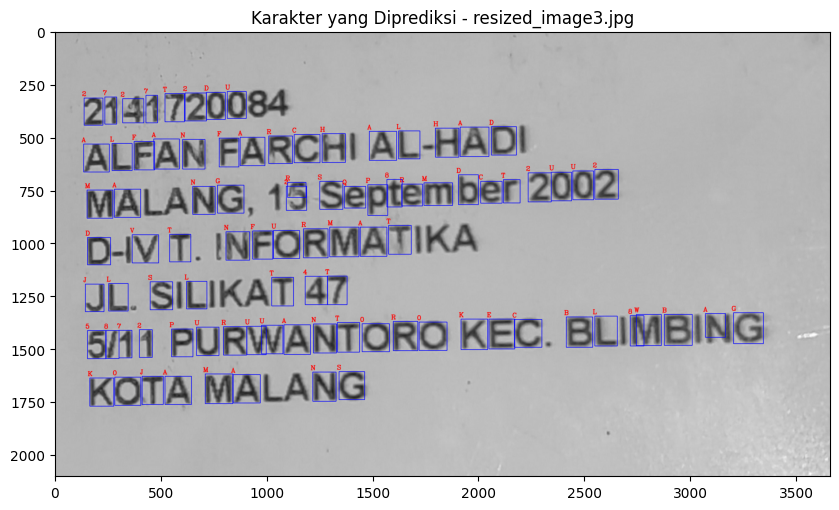

Jumlah kontur pada gambar resized_image4.jpg: 14170
3/3 [==============================] - 0s 23ms/step


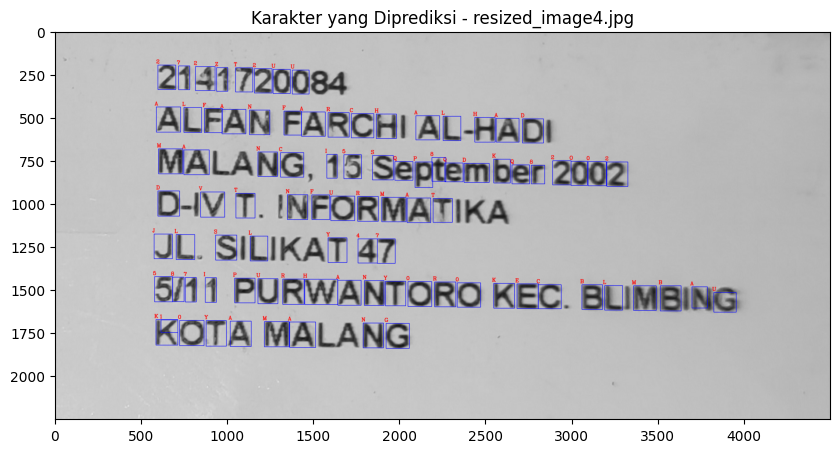

Jumlah kontur pada gambar resized_image5.jpg: 19999
3/3 [==============================] - 0s 20ms/step


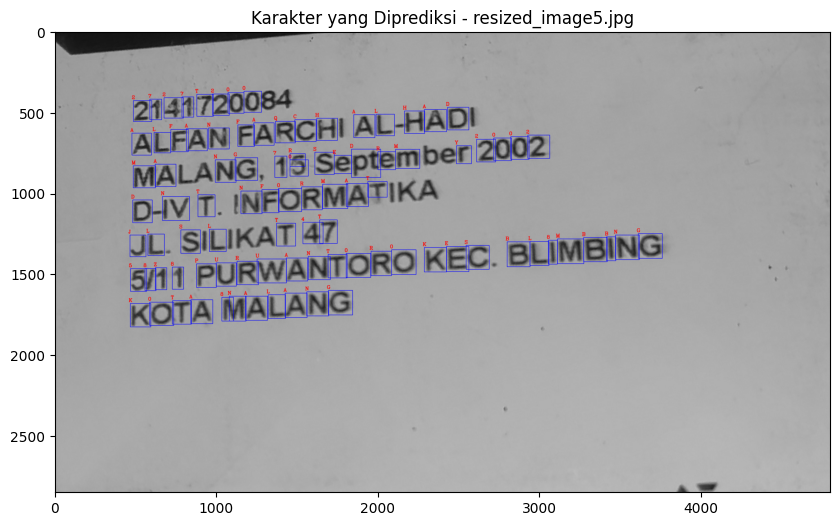

Jumlah kontur pada gambar resized_image6.jpg: 18175
3/3 [==============================] - 0s 31ms/step


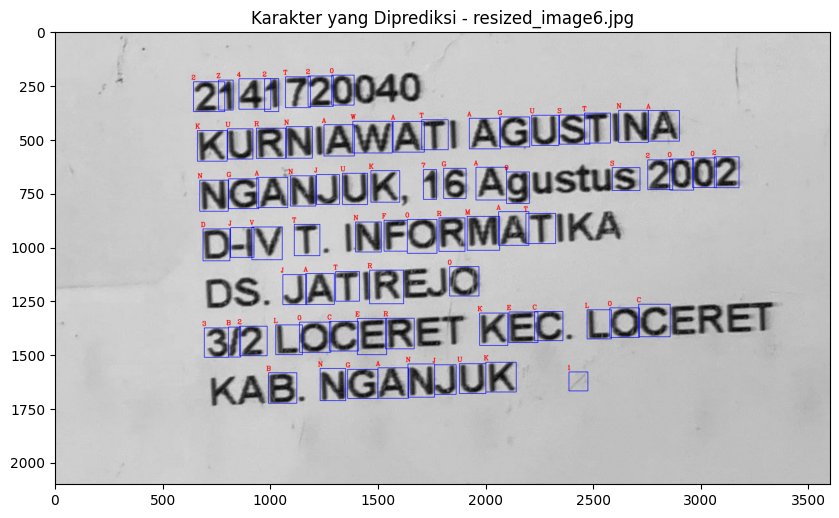

Jumlah kontur pada gambar resized_image7.jpg: 55664
3/3 [==============================] - 0s 18ms/step


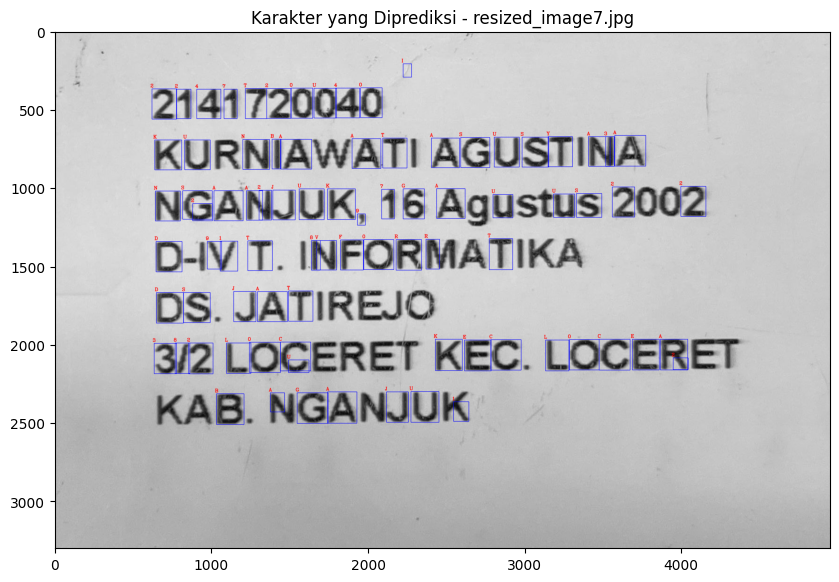

Jumlah kontur pada gambar resized_image8.jpg: 60610
3/3 [==============================] - 0s 15ms/step


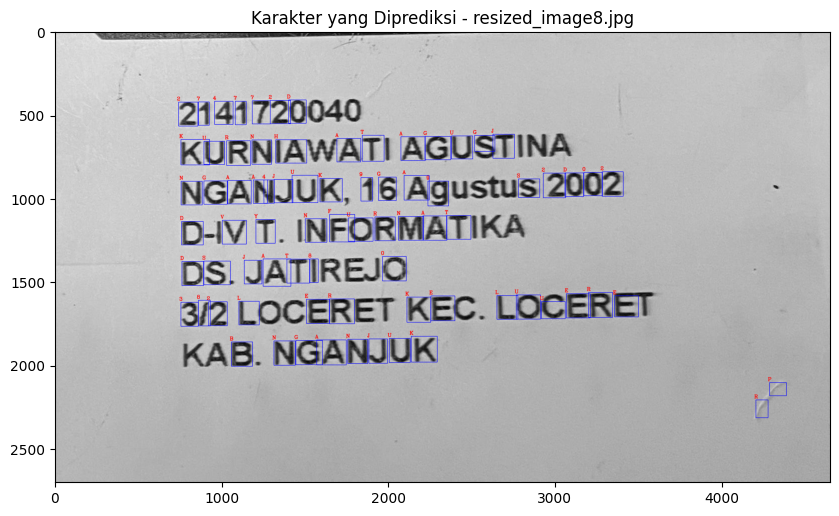

Jumlah kontur pada gambar resized_image9.jpg: 14363
3/3 [==============================] - 0s 16ms/step


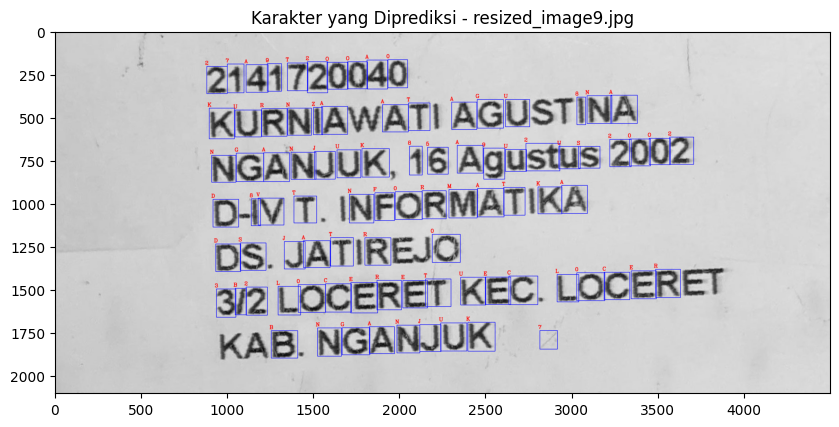

Jumlah kontur pada gambar resized_image10.jpg: 7590
3/3 [==============================] - 0s 14ms/step


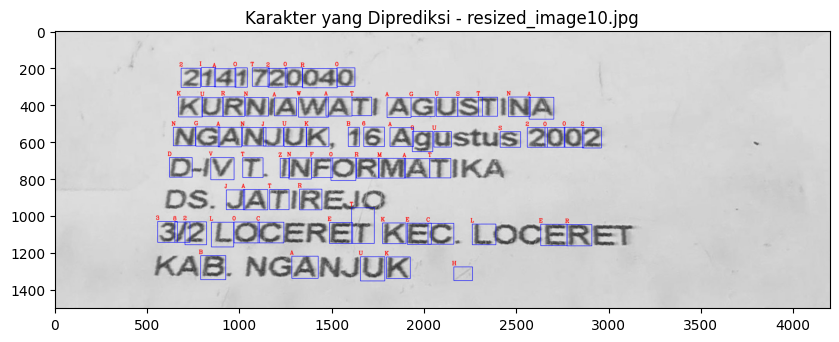

Jumlah kontur pada gambar resized_image11.jpg: 16328
3/3 [==============================] - 0s 16ms/step


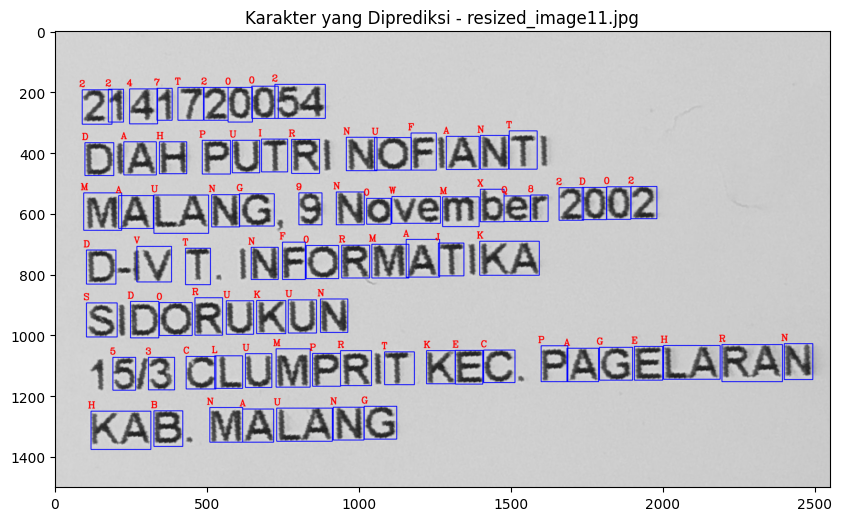

Jumlah kontur pada gambar resized_image12.jpg: 34817
3/3 [==============================] - 0s 16ms/step


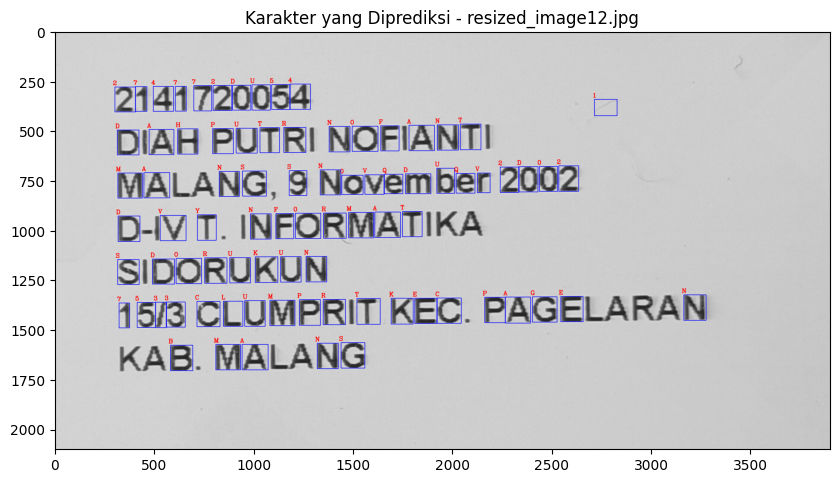

Jumlah kontur pada gambar resized_image13.jpg: 35508
3/3 [==============================] - 0s 18ms/step


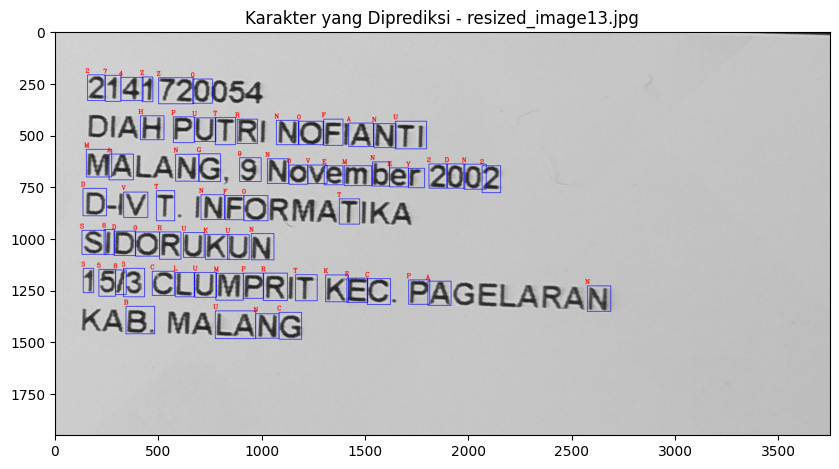

Jumlah kontur pada gambar resized_image14.jpg: 33175
3/3 [==============================] - 0s 14ms/step


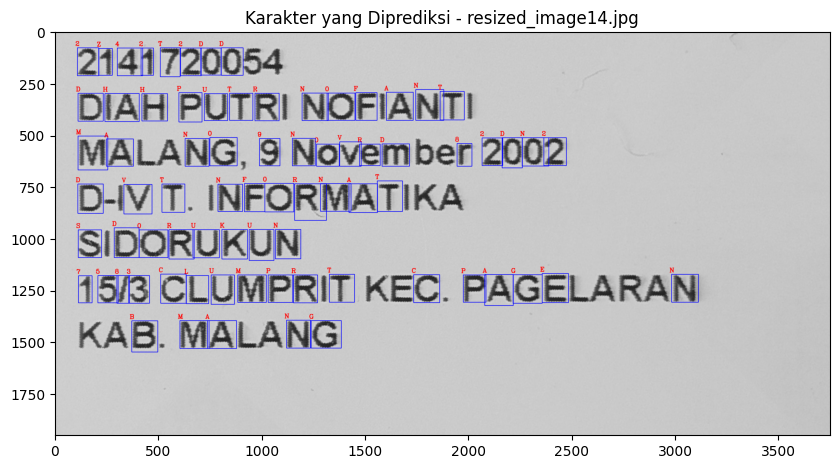

Jumlah kontur pada gambar resized_image15.jpg: 30982
3/3 [==============================] - 0s 16ms/step


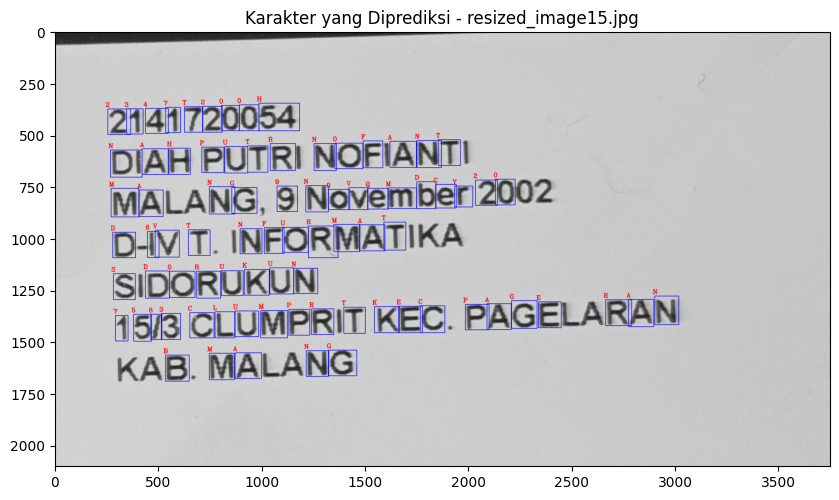

In [23]:
# Memuat atau mendefinisikan model jaringan saraf
network = load_model('/content/drive/MyDrive/PCVK/network')

# Mendefinisikan set karakter
digits = '0123456789'
letters_uppercase = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
letters_lowercase = 'abcdefghijklmnopqrstuvwxyz'
special_characters = '.,'

# Menggabungkan set karakter untuk membuat char_list
char_list = digits + letters_uppercase + letters_lowercase + special_characters

# Fungsi deteksi kontur
def temukan_kontur(img):
    conts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    conts = imutils.grab_contours(conts)
    conts = sorted(conts, key=cv2.contourArea, reverse=True)
    return conts

# Fungsi untuk memproses kotak pembatas
def proses_kotak(gray, x, y, w, h):
    roi = gray[y:y+h, x:x+w]
    thresh = cv2.threshold(roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    img_diubah = cv2.resize(thresh, (28, 28))
    img_normalisasi = img_diubah.astype('float32') / 255.0
    img_normalisasi = np.expand_dims(img_normalisasi, axis=-1)
    return img_normalisasi, (x, y, w, h)

# Path ke direktori yang berisi gambar yang sudah diubah ukurannya
direktori_gambar_diubah = '/content/drive/MyDrive/PCVK/Dataset_Kelompok4/ResizedImages'

# Dapatkan daftar semua file gambar di direktori
file_gambar = [f for f in os.listdir(direktori_gambar_diubah) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Atur lebar/tinggi minimum/maksimum untuk karakter
min_w, max_w = 50, 200  # Sesuaikan lebar minimum dan maksimum sesuai kebutuhan
min_h, max_h = 70, 200  # Sesuaikan tinggi minimum dan maksimum sesuai kebutuhan

# Iterasi melalui setiap gambar di direktori
for i, file_gambar in enumerate(file_gambar):
    # Baca gambar asli menggunakan OpenCV
    path_gambar = os.path.join(direktori_gambar_diubah, file_gambar)
    img = cv2.imread(path_gambar)
    img_copy = img.copy()  # gambar asli untuk menampilkan hasil deteksi kontur

    # Konversi ke citra skala abu-abu
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Terapkan threshold adaptif
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)

    # Temukan kontur pada gambar yang sudah diproses
    dilation = cv2.dilate(thresh, np.ones((3, 3)))
    kontur = temukan_kontur(dilation.copy())

    print(f"Jumlah kontur pada gambar {file_gambar}: {len(kontur)}")

    # Iterasi melalui kontur dan ekstrak karakter
    karakter_terdeteksi = []

    for j, c in enumerate(kontur):
        (x, y, w, h) = cv2.boundingRect(c)

        # Periksa apakah ukuran kotak pembatas berada dalam rentang yang spesifik
        if min_w <= w <= max_w and min_h <= h <= max_h:
            img_normalisasi, kotak_info = proses_kotak(gray, x, y, w, h)
            karakter_terdeteksi.append((img_normalisasi, kotak_info))

    # Prediksi
    piksel = np.array([px[0] for px in karakter_terdeteksi], dtype='float32')
    kotak = [box[1] for box in karakter_terdeteksi]
    prediksi = network.predict(piksel)

    # Tampilkan karakter dengan gambar asli
    img_copy2 = img.copy()

    for (pred, (x, y, w, h)) in zip(prediksi, kotak):
        i = np.argmax(pred)
        karakter_terdeteksi = char_list[i]

        cv2.rectangle(img_copy2, (x, y), (x+w, y+h), (255, 0, 0), 2)
        cv2.putText(img_copy2, karakter_terdeteksi, (x - 10, y - 10), cv2.FONT_HERSHEY_COMPLEX, 1, (0, 0, 255), 2)

    # Tampilkan gambar dengan karakter yang diprediksi
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(img_copy2, cv2.COLOR_BGR2RGB))
    plt.title(f'Karakter yang Diprediksi - {file_gambar}')
    plt.axis('on')
    plt.show()
